# Environment

Download miniforge  
`wget https://github.com/conda-forge/miniforge/releases/latest/download/Miniforge3-Linux-x86_64.sh -O Miniforge3.sh`  
`bash Miniforge3.sh -b -p "$HOME/miniforge3"`  

Install miniforge  
`"$HOME/miniforge3/bin/conda" init bash`  
Start a new shell, or:  
`source "$HOME/.bashrc"`   
  
Create environment  
`conda create -y -n spatial python=3.11`  
`conda activate spatial`  
`conda install -y ipykernel jupyterlab pyzmq jupyter_client "tornado<7"`  
  
Install Kernel to use with Jupyter Lab  
`python -m ipykernel install --user --name spatial --display-name "spatial"`

Install packages
`pip install numpy pandas matplotlib scipy scikit-image scikit-learn fastparquet`  
`pip install 'scanpy[leiden]'`  
`pip install squidpy` or `pip install 'squidpy[interactive]'` when installing locally to use Napari  

If you exceed disk quota clear your caches and remove Miniforge3.  
`conda clean -a -y && python -m pip cache purge`  
`rm -f Miniforge3.sh`

# Spatial Trascriptomics analysis

This tutorial will cover processing and basic analysis of Spatial Trascriptomics (10X Visium HD) data:
- quality control (QC)
- normalization
- spatially variable genes
- clustering
- Label transfer
- neighborhood analysis

The two most commonly used frameworks for spatial trascriptomics analysis are Scanpy, Squidpy and Seurat, for additional tutorials see the following links:
- Scanpy (Python) https://scanpy-tutorials.readthedocs.io/en/latest/
- Squidpy (Python) https://squidpy.readthedocs.io/en/stable/notebooks/tutorials/
- Seurat (R) https://satijalab.org/seurat/articles/spatial_vignette/

For additional informations and suggestions on spatial trascriptomics analysis, see:
- Single-cell best practices https://www.sc-best-practices.org/spatial/introduction.html

For this tutorial, we will focus on Scanpy and Squidpy tools. Information on Scanpy tools and their parameters can be found here: https://scanpy.readthedocs.io/en/stable/ 

## Datasets

The data was generated by 10X Genomics and downloaded from their server.  
  
We prepared 5 Visium HD (sequencing based spatial transcriptomics) datasets and 2 Xenium (imaging based spatial transcriptomics) datasets. These were downloaded with the below commands and unpacked. 
  
Visium Data:

- Mouse_1
    - https://www.10xgenomics.com/datasets/visium-hd-cytassist-gene-expression-libraries-of-mouse-kidney-v4
    - `curl -O https://cf.10xgenomics.com/samples/spatial-exp/4.0.1/Visium_HD_Mouse_Kidney/Visium_HD_Mouse_Kidney_binned_outputs.tar.gz`
    
- Mouse_2
    - https://www.10xgenomics.com/datasets/visium-hd-cytassist-gene-expression-libraries-of-mouse-kidney
    - `curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.0.0/Visium_HD_Mouse_Kidney/Visium_HD_Mouse_Kidney_binned_outputs.tar.gz`
    
 - Human_1
     - https://www.10xgenomics.com/datasets/visium-hd-cytassist-gene-expression-libraries-human-kidney-ffpe-v4
     - `curl -O https://cf.10xgenomics.com/samples/spatial-exp/4.0.1/Visium_HD_Human_Kidney_FFPE/Visium_HD_Human_Kidney_FFPE_binned_outputs.tar.gz`
 
 - Human_2
     - https://www.10xgenomics.com/datasets/visium-hd-cytassist-gene-expression-libraries-human-kidney-ffpe
     - `curl -O https://cf.10xgenomics.com/samples/spatial-exp/3.1.2/Visium_HD_Human_Kidney_FFPE/Visium_HD_Human_Kidney_FFPE_binned_outputs.tar.gz`
 - Macaque
   - https://www.10xgenomics.com/datasets/visium-hd-three-prime-rhesus-kidney-fresh-frozen
   - `curl -O https://cf.10xgenomics.com/samples/spatial-exp/4.0.1/Visium_HD_3prime_Rhesus_Kidney/Visium_HD_3prime_Rhesus_Kidney_binned_outputs.tar.gz`
   
     
Xenium Data:
There are also 2 Xenium datasts. If you want to also analyse imaging based spatial transcriptomics data, you can download them.

# Imports

In [2]:
#Basic libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from pathlib import Path
import json

#Spatial library
#Scanpy (Python) https://scanpy-tutorials.readthedocs.io/en/latest/
import scanpy as sc
#Squidpy (Python) https://squidpy.readthedocs.io/en/stable/notebooks/tutorials/
import squidpy as sq

/dodrio/scratch/users/vsc36066/miniforge3/envs/spatial/lib/python3.11/site-packages/dask/dataframe/__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
/dodrio/scratch/users/vsc36066/miniforge3/envs/spatial/lib/python3.11/site-packages/xarray_schema/__init__.py:1: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import DistributionNotFound, get_distribution
/dodrio/scratch/users/vsc36066/miniforge3/envs/spatial/lib/python3.11/site-packages/anndata/__init__.py:44: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata

## Visium data loading

### Folder structure
The data can be found in the `/data/Kidney/` folder. 

The Visium data can be found in the `mouse_1`, `mouse_2`, `human_1`, `human_2` and `macaque` folders.  
  
We will open the `mouse_1` folder as example but all folders should have the same structure.  

Visium HD has capture spots that are $2x2 \mu m$ large. These tiles are smaller than a cell and for convenience a binned version of the data is generally used. The binnend data can be found in the `binnend_outputs/square_XXXum` folders. However, the high resolution data `square_002um` is also present. For this tutorial we will look at the $16 \mu m$ binned data.  

### File info
The information of each dataset can be found by following the links above. For the `mouse_1` dataset, the info can be found [here](https://www.10xgenomics.com/datasets/visium-hd-cytassist-gene-expression-libraries-of-mouse-kidney-v4)  
For more information on the files that 10X genomics prepared as part of their Space Ranger pipeline, please see the [Space Ranger documentation](https://www.10xgenomics.com/support/software/space-ranger/latest/analysis/outputs/output-overview)

### Reading data
To read the data, we use the SCANPY `sc.read_10x_h5` function.

In [2]:
help(sc.read_10x_h5)

Help on function read_10x_h5 in module scanpy.readwrite:

read_10x_h5(filename: 'Path | str', *, genome: 'str | None' = None, gex_only: 'bool' = True, backup_url: 'str | None' = None) -> 'AnnData'
    Read 10x-Genomics-formatted hdf5 file.
    
    Parameters
    ----------
    filename
        Path to a 10x hdf5 file.
    genome
        Filter expression to genes within this genome. For legacy 10x h5
        files, this must be provided if the data contains more than one genome.
    gex_only
        Only keep 'Gene Expression' data and ignore other feature types,
        e.g. 'Antibody Capture', 'CRISPR Guide Capture', or 'Custom'
    backup_url
        Retrieve the file from an URL if not present on disk.
    
    Returns
    -------
    Annotated data matrix, where observations/cells are named by their
    barcode and variables/genes by gene name. Stores the following information:
    
    :attr:`~anndata.AnnData.X`
        The data matrix is stored
    :attr:`~anndata.AnnData.obs_n

In [4]:
#path to the data folder
data_path = Path('../data/Kidney/mouse_1/binned_outputs/square_016um/')

#Open the data, and return an Anndata file
ad = sc.read_10x_h5(data_path / 'filtered_feature_bc_matrix.h5')
ad.var_names_make_unique()
ad

/dodrio/scratch/users/vsc36066/miniforge3/envs/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1793: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/dodrio/scratch/users/vsc36066/miniforge3/envs/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1793: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 126113 × 19070
    var: 'gene_ids', 'feature_types', 'genome'

### Anndata
The [Anndata](https://anndata.readthedocs.io/en/stable/) file format is basically a matrix of observations by variables. In this case there are 126113 observations, which correspond to the binned tiles of the Visium HD array. The 19070 variable correspond to the measured genes.  
  
At this point the Anndata object is quite empty, it just contains the gene expression values. However, we see that there are 3 variables present:

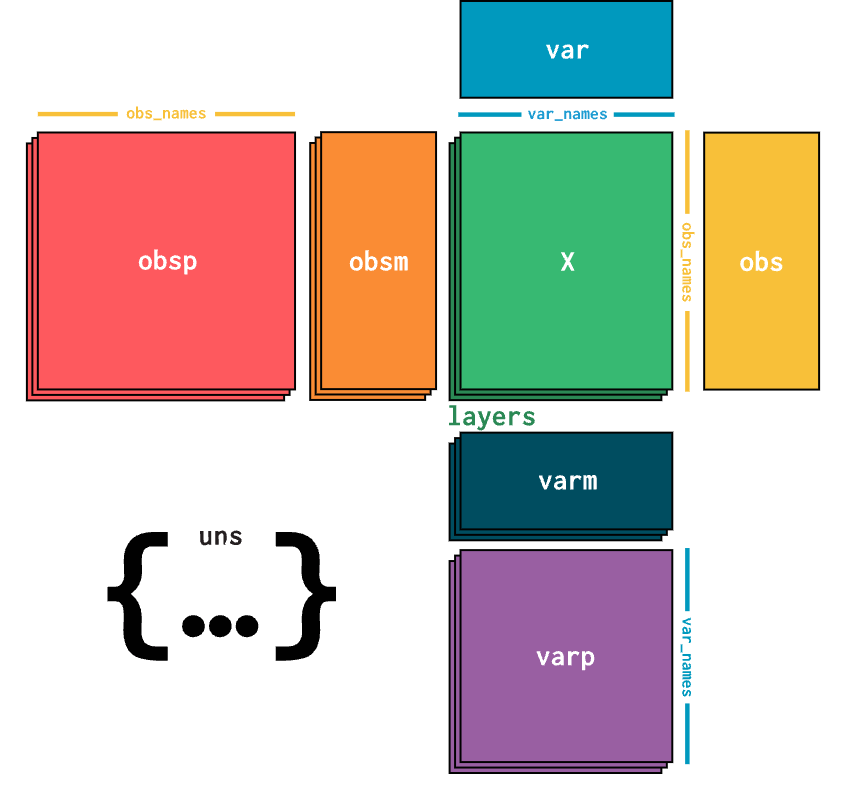

In [5]:
#Ensemble gene ID
ad.var['gene_ids']

Xkr4       ENSMUSG00000051951
Rp1        ENSMUSG00000025900
Sox17      ENSMUSG00000025902
Lypla1     ENSMUSG00000025903
Tcea1      ENSMUSG00000033813
                  ...        
mt-Nd4l    ENSMUSG00000065947
mt-Nd4     ENSMUSG00000064363
mt-Nd5     ENSMUSG00000064367
mt-Nd6     ENSMUSG00000064368
mt-Cytb    ENSMUSG00000064370
Name: gene_ids, Length: 19070, dtype: object

In [6]:
#Type of feature
ad.var['feature_types']

Xkr4       Gene Expression
Rp1        Gene Expression
Sox17      Gene Expression
Lypla1     Gene Expression
Tcea1      Gene Expression
                ...       
mt-Nd4l    Gene Expression
mt-Nd4     Gene Expression
mt-Nd5     Gene Expression
mt-Nd6     Gene Expression
mt-Cytb    Gene Expression
Name: feature_types, Length: 19070, dtype: object

In [7]:
#Genome the read is mapped to. 
ad.var['genome']

Xkr4       GRCm39
Rp1        GRCm39
Sox17      GRCm39
Lypla1     GRCm39
Tcea1      GRCm39
            ...  
mt-Nd4l    GRCm39
mt-Nd4     GRCm39
mt-Nd5     GRCm39
mt-Nd6     GRCm39
mt-Cytb    GRCm39
Name: genome, Length: 19070, dtype: object

### Adding data
You might have noticed that our Anndata object does not contain any spatial information. This data we need to fetch from another file. 

In [8]:
# Open spatial metadata
xy = pd.read_parquet(data_path / 'spatial/tissue_positions.parquet', engine='fastparquet')
xy

,barcode,in_tissue,array_row,array_col,pxl_row_in_fullres,pxl_col_in_fullres
0,s_016um_00000_00000-1,0,0,0,26710.418528,4711.708022
1,s_016um_00000_00001-1,0,0,1,26710.255895,4770.129795
2,s_016um_00000_00002-1,0,0,2,26710.093263,4828.551576
3,s_016um_00000_00003-1,0,0,3,26709.930630,4886.973364
4,s_016um_00000_00004-1,0,0,4,26709.767997,4945.395159
...,...,...,...,...,...,...
175556,s_016um_00418_00414-1,0,418,414,2222.038492,28831.241002
175557,s_016um_00418_00415-1,0,418,415,2221.874317,28889.667127
175558,s_016um_00418_00416-1,0,418,416,2221.710142,28948.093260
175559,s_016um_00418_00417-1,0,418,417,2221.545966,29006.519400


In [9]:
# Sort in same order as anndata object
xy.set_index('barcode', inplace=True)
xy = xy.loc[ad.obs.index]

# Add spatial coordinates to anndata object
spatial = xy.loc[:, ['pxl_col_in_fullres', 'pxl_row_in_fullres']].to_numpy()
ad.obsm['spatial'] = spatial

ad

AnnData object with n_obs × n_vars = 126113 × 19070
    var: 'gene_ids', 'feature_types', 'genome'
    obsm: 'spatial'

Now you can see that our Anndata object now also contains the spatial coordinates in the `obsm` structure.  
Data vectors of one dimention that match the observations are strored in `obs`. Data structures with multiple dimension (but one aligning to the observations) are stored in `obsm`. The same goes for `var` and `varm` that contain data linked to the variables. 
  
In the steps below you will see that analysis results are often directly added to the Anndata object. 

### Image
Lastly we will open the linked Hematoxylin and Eosin stain (H&E) image of the tissue. For each dataset there is a low and a high resolution image. Then we will then add the images to the Anndata object

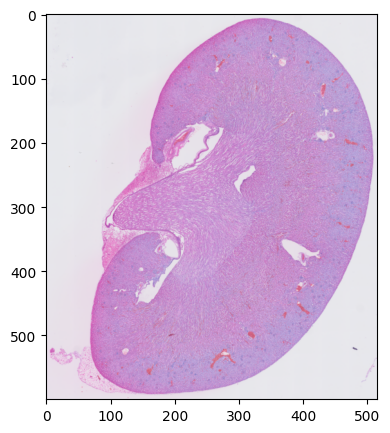

In [10]:
#Open and plot the image
plt.figure(figsize=(5,5))
img_path = data_path / 'spatial/tissue_lowres_image.png'
img = mpimg.imread(img_path)
img = np.flipud(img) #Flip because images and scatter plots have different origin positions. 
plt.imshow(img)

In [11]:
#Images should go to the Unstructured (uns) data, because it does not align with the main axis of observations or variables
#First make a dictionary for all spatial data, and the dataset.
ad.uns['spatial'] = {}
ad.uns['spatial']['mouse_1'] = {}

#Add the images
lowres_path =  data_path / 'spatial/tissue_lowres_image.png'
hires_path =  data_path / 'spatial/tissue_hires_image.png'
ad.uns['spatial']['mouse_1']['images'] = {'hires' :  mpimg.imread(hires_path),
                                         'lowres':  mpimg.imread(lowres_path)}

#The images need to be scaled to match the transcriptomics data. 
#The scaling parameters are saved in a json file
scalefactors_path = data_path / 'spatial/scalefactors_json.json'
scalefactors = json.load(open(scalefactors_path, 'r'))
ad.uns['spatial']['mouse_1']['scalefactors'] = scalefactors



Now you can see that we added the images to `ad.uns['spatial']` and the spatial coordinates are in `ad.obsm['spatial']`

In [12]:
ad

AnnData object with n_obs × n_vars = 126113 × 19070
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

# Opening visium data
To simplify opening the 10X Visium data, we have prepared a function:

In [13]:
def open_visium(path, resolution=8):
    """
    Load a 10X Genomics Visium dataset as an AnnData object with binned spatial coordinates.

    Parameters
    ----------
    path : str or Path
        Path to the root folder of the Visium sample. The function expects the following structure:
    resolution : int, optional (default=8)
        Resolution of binning in micrometers. Valid resolutions are 2, 8 and 16. 
    Returns
    -------
    AnnData
        An AnnData object with:
        - `X`: filtered counts matrix from `filtered_feature_bc_matrix.h5`
        - `obs`: barcodes
        - `var`: gene metadata
        - `obsm['spatial']`: NumPy array of shape (n_obs, 2) with `array_col` and `array_row` spatial coordinates
        
    """
    #Find files
    path = Path(path)
    name = path.name
    resolution = str(resolution).zfill(3)
    binning = f'square_{resolution}um'
    path = path / 'binned_outputs' / binning 
    ad_path = path / 'filtered_feature_bc_matrix.h5'
    positions_path = path / 'spatial/tissue_positions.parquet'
    lowres_path =  path / 'spatial/tissue_lowres_image.png'
    hires_path =  path / 'spatial/tissue_hires_image.png'
    scalefactors_path = path / 'spatial/scalefactors_json.json'
    
    #Open data
    ad = sc.read_10x_h5(ad_path)
    ad.var_names_make_unique()

    # Open spatial metadata
    hd_xy = pd.read_parquet(positions_path, engine='fastparquet')
    
    # Sort in same order as anndata object
    hd_xy.set_index('barcode', inplace=True)
    hd_xy = hd_xy.loc[ad.obs.index]

    # Add spatial coordinates to anndata
    spatial = hd_xy.loc[:, ['pxl_col_in_fullres', 'pxl_row_in_fullres']].to_numpy()
    ad.obsm['spatial'] = spatial
    
    #Initiate image data
    ad.uns['spatial'] = {}
    ad.uns['spatial'][name] = {}

    #Add the images
    ad.uns['spatial'][name]['images'] = {'hires' :  mpimg.imread(hires_path),
                                         'lowres':  mpimg.imread(lowres_path)}
    
    #Add scale factors
    scalefactors = json.load(open(scalefactors_path, 'r'))
    ad.uns['spatial'][name]['scalefactors'] = scalefactors
    
    return ad

## Visulization of Spatial Trascriptomics data
We use the Squidpy package for plotting the spatial data with the `sq.pl.spatial_scatter` function to overlay barcoded spots on top of the Hematoxylin and eosin stain (H&E) image provided. The function `sq.pl.spatial_scatter` accepts an additional paremeter named `color` to display annotations of observations or genes.

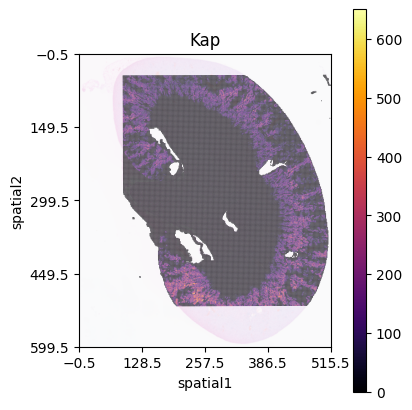

In [14]:
#Now we can plot the image with the gene expression data
plt.rcParams["figure.figsize"] = (4, 4)
ax = sq.pl.spatial_scatter(ad, color=["Kap"], img_alpha=0.2, return_ax=True, img_res_key='lowres', cmap='inferno')

ax.set_xticks(np.linspace(*ax.get_xlim(), 5))
ax.set_yticks(np.linspace(*ax.get_ylim(), 5))
for spine in ax.spines.values(): spine.set_visible(True)

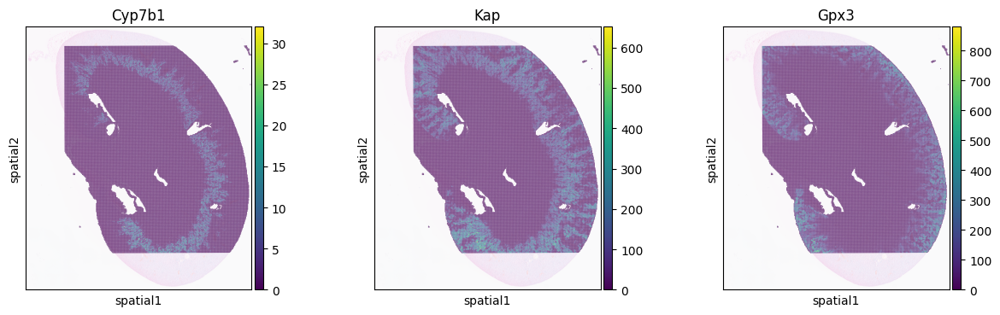

In [15]:
#We can also plot multiple genes in the same plot
plt.rcParams["figure.figsize"] = (4, 4)
sq.pl.spatial_scatter(ad, color=['Cyp7b1', 'Kap', 'Gpx3'], img_alpha=0.2,)

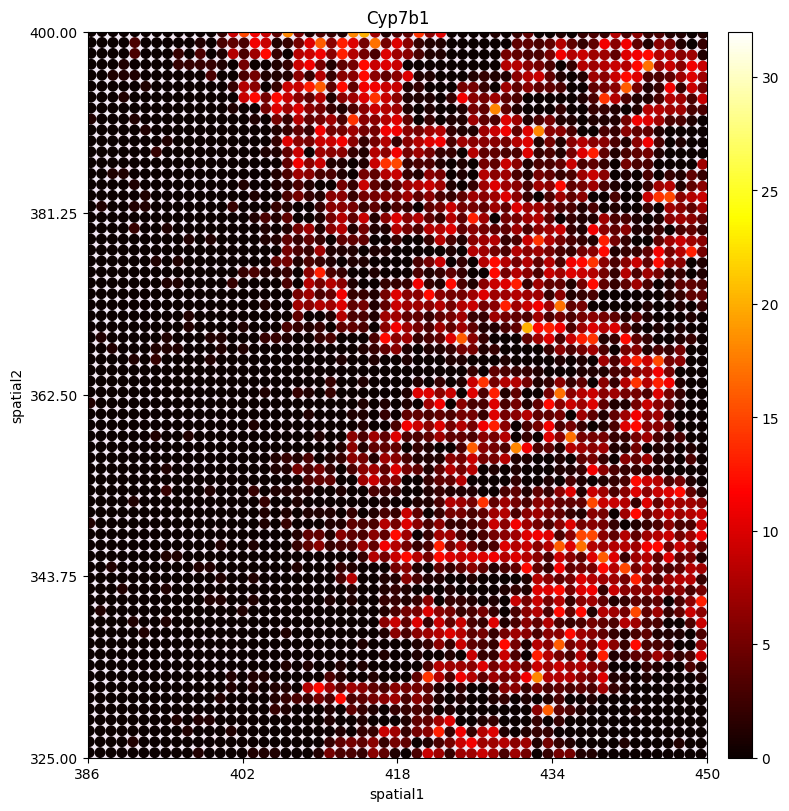

In [16]:
#We can also plot multiple genes in the same plot
plt.rcParams["figure.figsize"] = (8, 8)
ax = sq.pl.spatial_scatter(ad, color=['Cyp7b1'], img_alpha=0.2, cmap='hot', img_res_key='lowres', return_ax=True)

ax.set_xlim([386, 450])
ax.set_ylim([325, 400])
ax.set_xticks(np.linspace(*ax.get_xlim(), 5))
ax.set_yticks(np.linspace(*ax.get_ylim(), 5))
for spine in ax.spines.values(): spine.set_visible(True)

## QC and preprocessing

The choosen resolution for 10X Visium HD bins is $16 \mu m$, this means that each spot can contain or partially overlap with one cell, or multiple cells of different identity. For this reason, contrary to `scRNA-seq` analysis, we do not perform a doublet detection step during quality control. 

Instead we compute standard QC metrics with `sc.pp.calculate_qc_metrics` and percentage of mitochondrial read counts per sample.

In [17]:
ad.var["mt"] = ad.var_names.str.startswith("mt-")
sc.pp.calculate_qc_metrics(ad, qc_vars=["mt"], inplace=True)

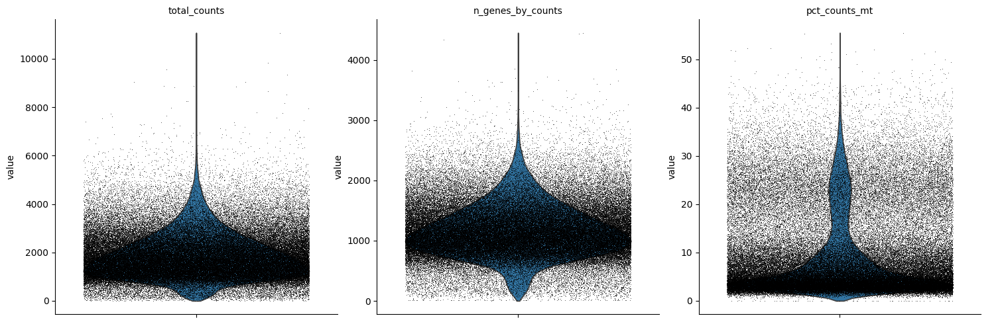

In [18]:
sc.pl.violin(ad, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt'], jitter=0.4, multi_panel=True, size=0.5)

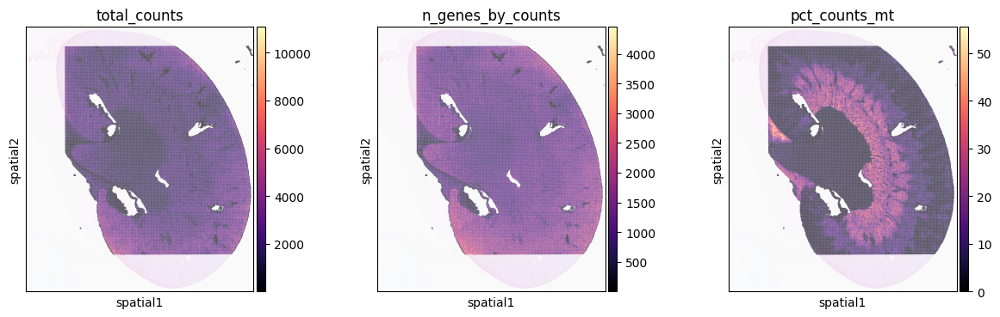

In [19]:
plt.rcParams["figure.figsize"] = (4, 4)
sq.pl.spatial_scatter(ad, color=["total_counts", "n_genes_by_counts", "pct_counts_mt"], cmap='magma', img_alpha=0.2)

Since a single spot can partially overlap with one or multiple cells we do not heavily filter out spots with high counts because they might ovelap with dense tissue areas. We instead set a low threshold for the minimum number of genes and counts required per spot to remove low quality data, e.g. broken or empty tissue areas.

We have decided not to filter spots with high mitochondria gene counts because although they might indicate presence of broken or dying cells, we do not notice any specific tissue damage from the H&E image in areas where mitochondria gene counts are high.

In [20]:
sc.pp.filter_cells(ad, min_counts=100) # Filter spots with less than 100 counts
sc.pp.filter_cells(ad, min_genes=100) # Filter spots with less than 100 genes
sc.pp.filter_genes(ad, min_cells=100) # Filter genes expressed in less than 100 spots

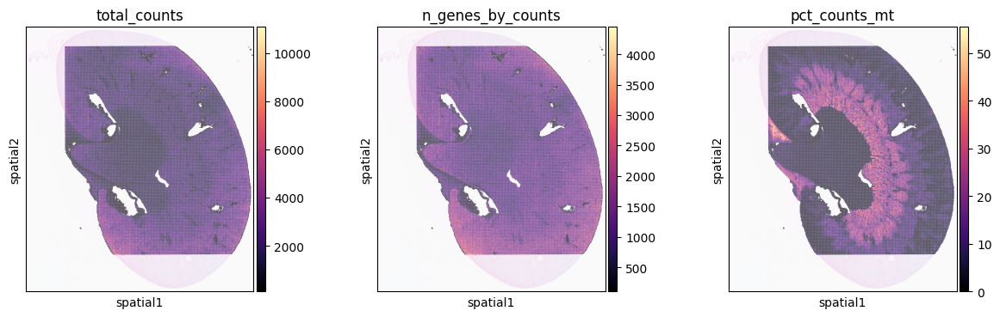

In [21]:
sq.pl.spatial_scatter(ad, color=["total_counts", "n_genes_by_counts", "pct_counts_mt"], cmap='magma', img_alpha=0.2)

## Normalization
We have seen that total counts (number of UMIs) vary significantly between spots. This is mainly due to the tissue anatomy but also due to technical factors that introduce non biological variations that we wish to remove by normalizing the data with respect to total counts of UMIs per spot.

In [22]:
#Store raw data in the `raw` layer
ad.raw = ad.copy()

#Normalize data
sc.pp.normalize_total(ad, inplace=True)
sc.pp.log1p(ad)

## Spatially variable genes
Similarly to `scRNA-seq` data analysis, we wish to reduce the dimensionality of the dataset by identify highly-variable genes (HVGs). HVGs are genes which show significantly different expression profiles between cells or distinct groups. This kind of analysis can also be applied to spatial data, however, methods designed for this task do not take into account the spatial context and spatial relationships between cells/spots. A gene might for example be highly variable, but not show a distinct spatial pattern and is therefore not spatially variable.

In [23]:
# Find highly variable genes
sc.pp.highly_variable_genes(ad)
hvg = ad.var_names[ad.var.highly_variable==True]
ad.var[ad.var.highly_variable==True].head()

,gene_ids,feature_types,genome,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm
Sox17,ENSMUSG00000025902,Gene Expression,GRCm39,False,5318,0.053048,0.051688,95.783147,6690.0,8.808518,5317,True,0.066396,0.926485,2.177411
Prex2,ENSMUSG00000048960,Gene Expression,GRCm39,False,6953,0.057726,0.056121,94.486691,7280.0,8.893023,6952,True,0.065680,0.548108,0.623000
Sbspon,ENSMUSG00000032719,Gene Expression,GRCm39,False,5814,0.052968,0.051613,95.389849,6680.0,8.807023,5814,True,0.069027,0.635577,0.982331
Sema4c,ENSMUSG00000026121,Gene Expression,GRCm39,False,3118,0.025509,0.025189,97.527614,3217.0,8.076515,3118,True,0.031077,0.540977,0.593705
Tbc1d8,ENSMUSG00000003134,Gene Expression,GRCm39,False,3117,0.025438,0.025119,97.528407,3208.0,8.073714,3117,True,0.030858,0.631324,0.964860


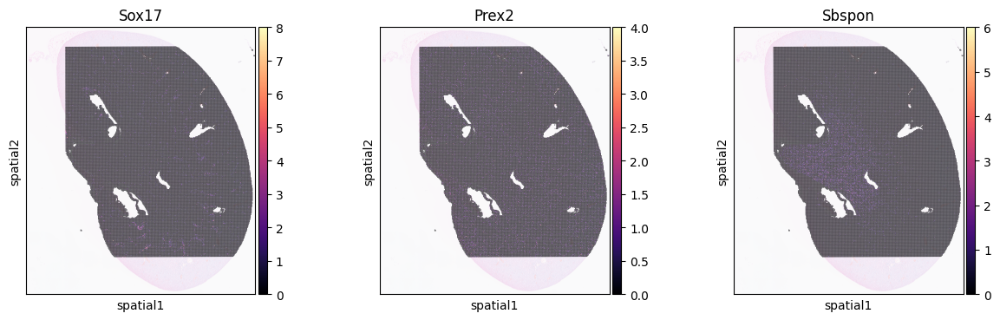

In [24]:
sq.pl.spatial_scatter(ad, color=['Sox17', 'Prex2','Sbspon'], cmap='magma', img_alpha=0.2)

In order to identify **spatially variable genes** (SVG), we need to decompose spatial and non-spatial variations in gene expression. Genes that show variatiation in gene expression predominantly due to spatial variation can be said that are spatially variable ([Walker et al., 2022](https://doi.org/10.1038/s42003-022-03175-5)).

Several methods have been proposed to identify spatially variable genes:
- SpatialDE ([Svensson et al., 2018](https://doi.org/10.1038/nmeth.4636))
- SpatialDE2 ([Kats et al., 2021](https://doi.org/10.1101/2021.10.27.466045))
- SPARK ([Zhu et al., 2021](https://doi.org/10.1186/s13059-021-02404-0))
- Sepal ([Andersson and Lundeberg, 2021](https://doi.org/10.1093/bioinformatics/btab164))
- scGCO ([Zhang et al., 2022](https://doi.org/10.1038/s41467-022-33182-3))
- SpaGCN ([Hu et al., 2021](https://doi.org/10.1038/s41592-021-01255-8))

A simple and straightfoward method to identify SVGs is to measure the spatial autocorrelation of each gene with [Moran’s I](https://en.wikipedia.org/wiki/Moran%27s_I) statistics. For this task we are going to use `Squidpy`, a complementary Python package to `Scanpy` (https://squidpy.readthedocs.io/en/stable/index.html) specifically desigin for analysing spatial data.

We first construct a spatial graph by connecting proximal spots based on their X,Y coordinates.

In [25]:
sq.gr.spatial_neighbors(ad, n_neighs=8) # Build spatial graph. Visium HD uses a square grid so we choose the 8 closest neighbours

We then compute Morans's I statistics for each gene.  
In the example below you can see the what the statistics captures. If the data is randomly distributed the value is low. On the other hand, if the values are all close togheter, in other words spatially autocorrelated, Moran's I will be high. 

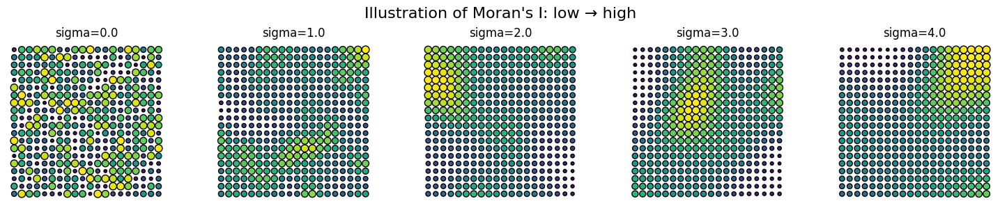

In [26]:
#Quick example of Morans I statistic
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import rankdata
from scipy.ndimage import gaussian_filter

np.random.seed(42)

grid_size = 20  # number of points along one axis
n_patterns = 5

fig, axes = plt.subplots(1, n_patterns, figsize=(15, 3))

for i, sigma in enumerate(np.linspace(0, 4, n_patterns)):
    # Start with random values
    values = np.random.rand(grid_size, grid_size)
    
    # Smooth values with Gaussian filter to increase spatial autocorrelation
    smoothed = gaussian_filter(values, sigma=sigma)
    
    # Flatten for plotting
    X, Y = np.meshgrid(np.arange(grid_size), np.arange(grid_size))
    X = X.flatten()
    Y = Y.flatten()
    Z = smoothed.flatten()
    
    # Normalize marker size
    size = 50 * (Z - Z.min()) / (Z.max() - Z.min()) + 10
    
    axes[i].scatter(X, Y, s=size, c=Z, cmap='viridis', edgecolor='k')
    axes[i].set_title(f'sigma={sigma:.1f}')
    axes[i].axis('off')
    axes[i].set_aspect('equal')

plt.suptitle("Illustration of Moran's I: low → high", fontsize=16)
plt.tight_layout()
plt.show()


In [27]:
sq.gr.spatial_autocorr(ad, mode="moran", genes=ad.var_names) # Moran's I statistic
ad.uns["moranI"]

,I,pval_norm,var_norm,pval_norm_fdr_bh
Cfd,0.885021,0.000000,0.000002,0.000000
Kap,0.870011,0.000000,0.000002,0.000000
Gpx3,0.863338,0.000000,0.000002,0.000000
Car3,0.843798,0.000000,0.000002,0.000000
Akr1b3,0.837589,0.000000,0.000002,0.000000
...,...,...,...,...
Nupr1l,-0.002483,0.040511,0.000002,0.046706
Zfp991,-0.002518,0.038385,0.000002,0.044401
Phf21b,-0.002826,0.023453,0.000002,0.027669
Zfp322a,-0.003098,0.014666,0.000002,0.017674


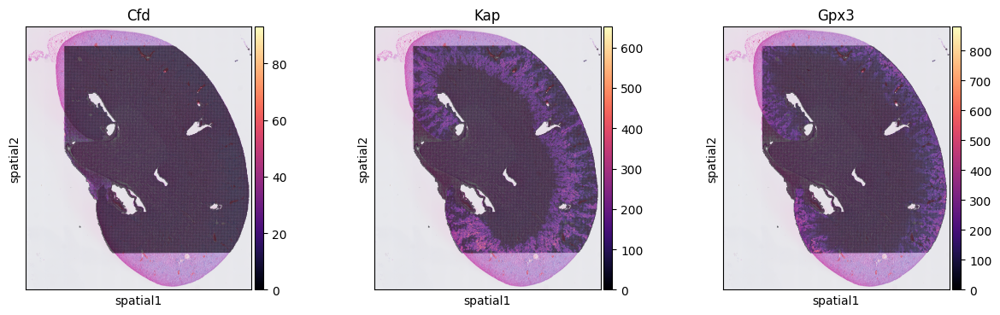

In [28]:
sq.pl.spatial_scatter(ad, color=['Cfd', 'Kap', 'Gpx3'], cmap='magma')

## Principal components on spatially variable genes

We can compute principal component analysis based on SVG to extract spatially varing components that most likely represent gene programs active in different tissue areas.

We first define SVGs by setting a threhsold on the Moran's I score.

In [29]:
svg = ad.uns["moranI"][ad.uns["moranI"].I>0.3].index.to_list()
highly_variable_filt = ad.var_names.isin(svg)

We then compute PCA on the SVG and visualize the principal components and their loadings. We first save log-normalized values in `hd.log_norm`

In [30]:
# # save log-normalized expression values
# hd.log_norm = hd

sc.pp.scale(ad)
sc.pp.pca(ad, n_comps=50, mask_var = highly_variable_filt)

/dodrio/scratch/users/vsc36066/miniforge3/envs/spatial/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


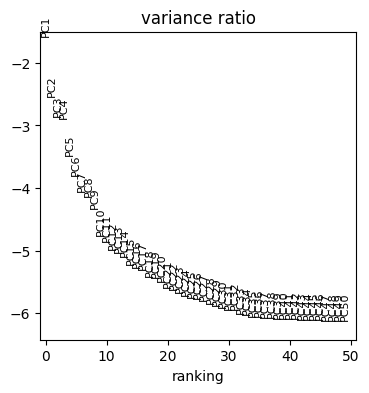

In [31]:
sc.pl.pca_variance_ratio(ad, log=True, n_pcs=50)

In [32]:
ad.obs = ad.obs.join(pd.DataFrame(ad.obsm['X_pca'], index=ad.obs.index, columns=['PC'+str(x+1) for x in np.arange(ad.varm['PCs'].shape[1])]))

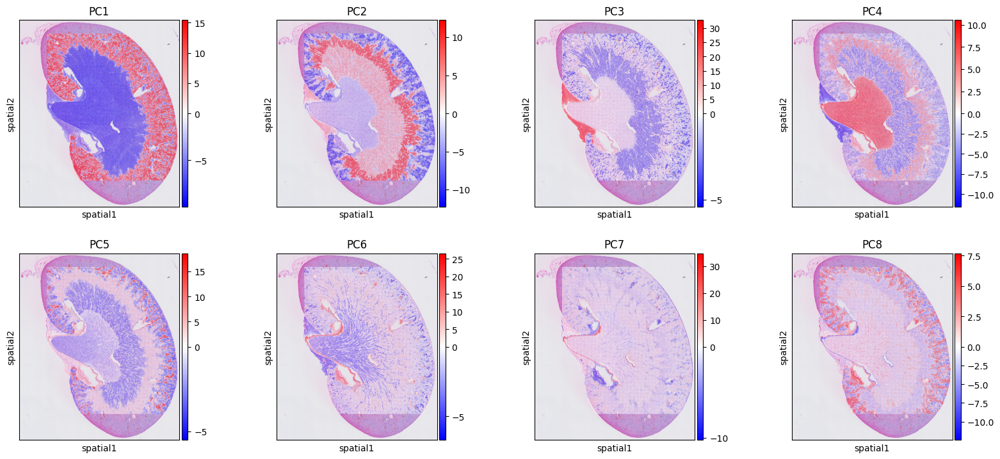

In [33]:
sq.pl.spatial_scatter(ad, color=['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8'], cmap='bwr', vcenter=0)

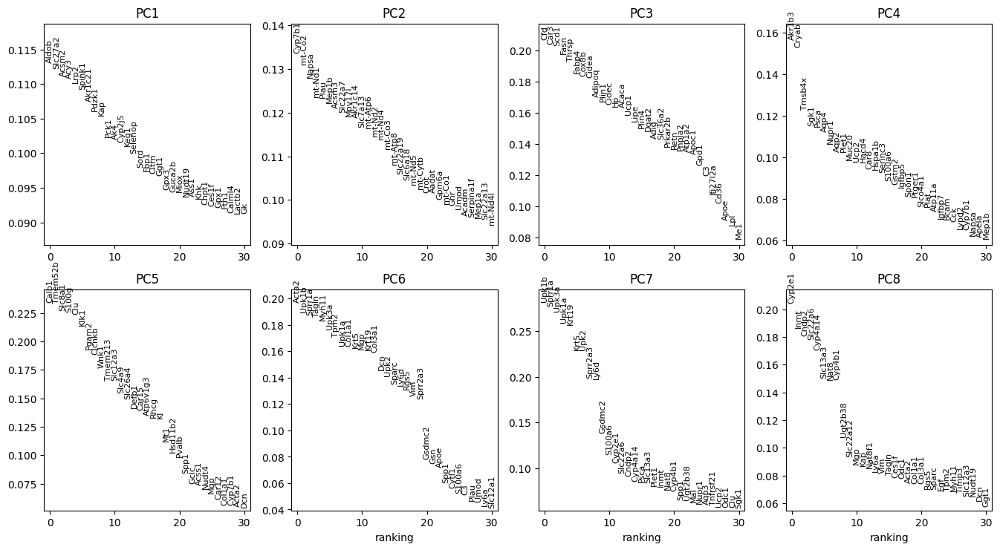

In [34]:
sc.pl.pca_loadings(ad, components='1,2,3,4,5,6,7,8', include_lowest=False)

## Spatial domains
We can now explore how tissue architecture is spatially defined in different compartments with different gene expression and cell-type composition. We first compute the gene expression and spatial neighborhood graph.

In [35]:
# nearest neighbor graph
sc.pp.neighbors(ad, use_rep='X_pca')
nn_graph_genes = ad.obsp["connectivities"]

# spatial proximity graph
sq.gr.spatial_neighbors(ad)
nn_graph_space = ad.obsp["spatial_connectivities"]

We then cluster the gene expression using leiden clustering.

In [36]:
# Run leiden clustering
sc.tl.leiden(ad, resolution=2, adjacency=nn_graph_genes, key_added="leiden")

/tmp/ipykernel_721036/2912040317.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(ad, resolution=2, adjacency=nn_graph_genes, key_added="leiden")


Obtained clusters represent cell-type specific gene expression programs localized in different tissue areas.

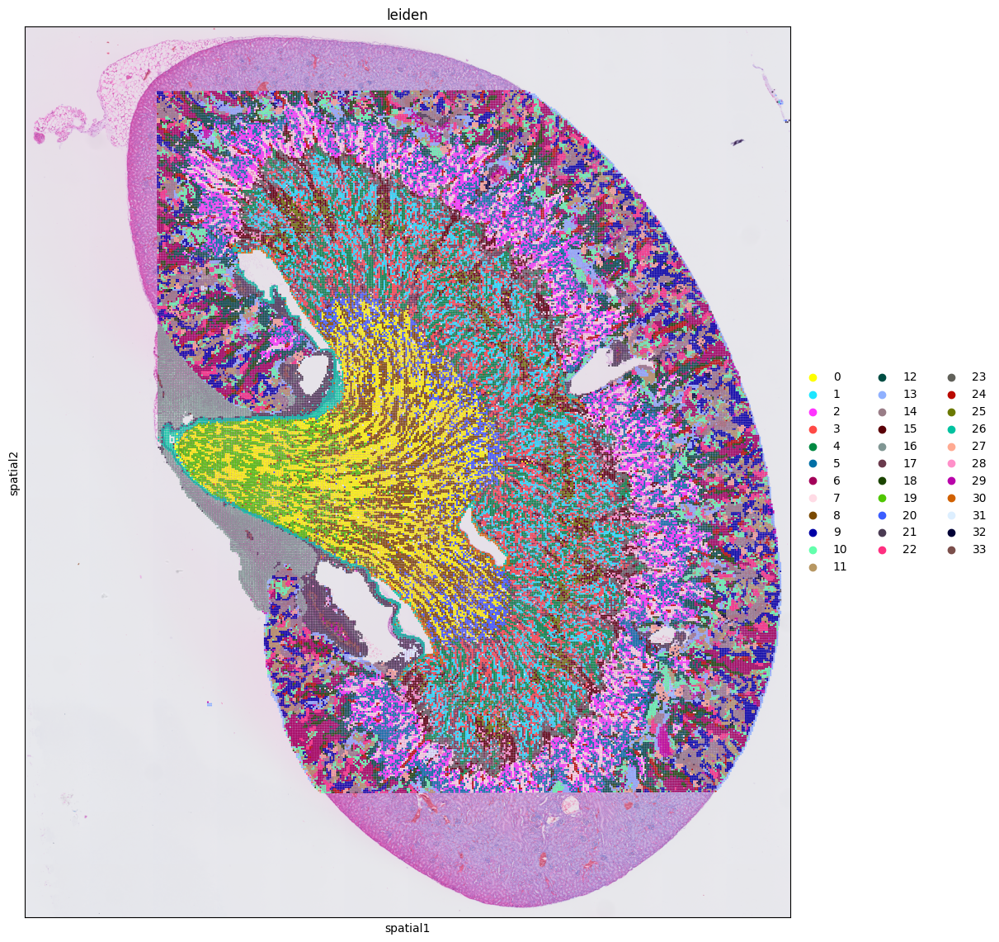

In [37]:
plt.rcParams["figure.figsize"] = (12, 12)
sq.pl.spatial_scatter(ad, color=["leiden"], )

To find broader anatomical tissue domains we can blend the neighborhood graph in pca space with the spatial neighborhood graph in spatial coordinates.

In [38]:
# Blend neighborhood and spatial neighborhood graph
# ! This takes some time !
alpha = 0.5
joint_graph = (1 - alpha) * nn_graph_genes + alpha * nn_graph_space
# Run leiden clustering
sc.tl.leiden(ad, resolution=2, adjacency=joint_graph, key_added="spatial_domains")

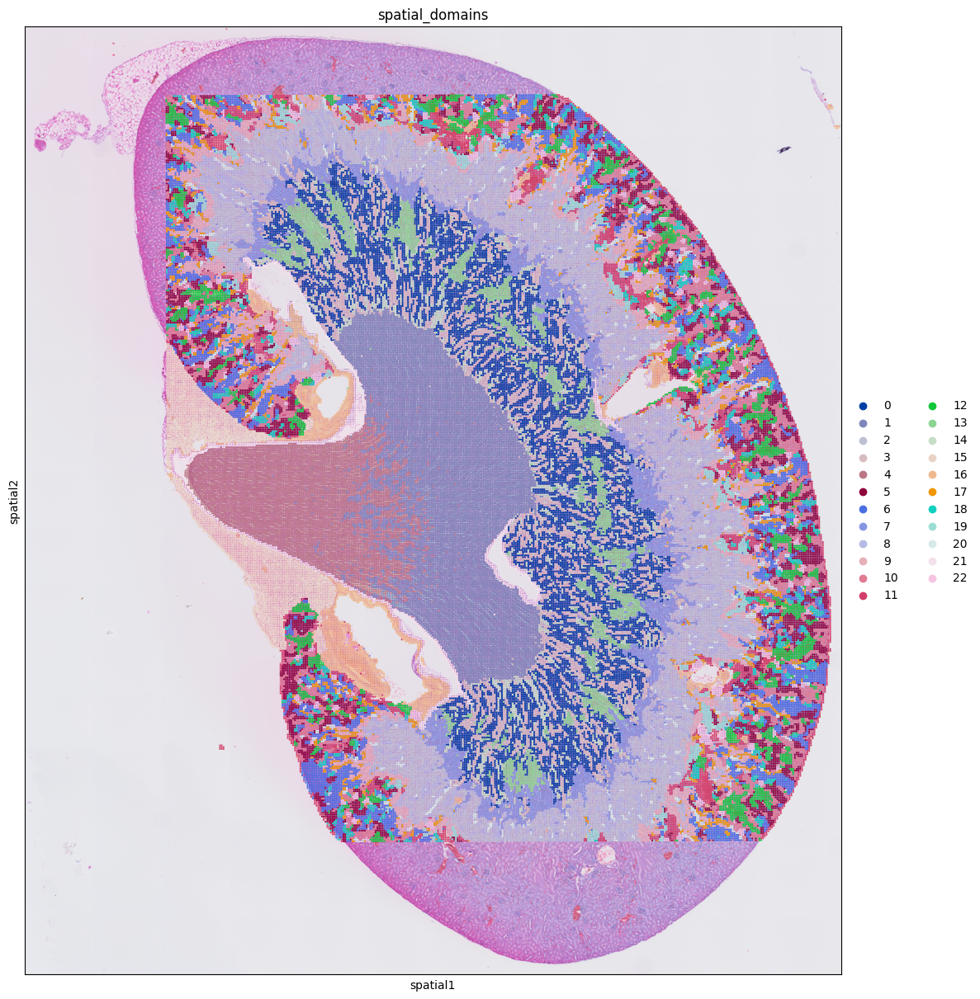

In [39]:
plt.rcParams["figure.figsize"] = (12, 12)
sq.pl.spatial_scatter(ad, color=["spatial_domains"])

More advanced methods to cluster spatial data are broadly available in literature, here are some examples:
- [Clustermap](https://doi.org/10.1038/s41467-021-26044-x)
- [spaGCN](https://doi.org/10.1038/s41592-021-01255-8)
- [stLearn](https://doi.org/10.1101/2020.05.31.125658)
- [BayesSpace](https://doi.org/10.1038/s41587-021-00935-2)
- [SpatialGlue](https://doi.org/10.1038/s41592-024-02316-4)
- [TopACT](https://doi.org/10.1038/s41586-024-07563-1)

We can now compute marker genes for these clusters to help us understand their cell-type composition and annotate the different tissue regions.

/dodrio/scratch/users/vsc36066/miniforge3/envs/spatial/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:456: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/dodrio/scratch/users/vsc36066/miniforge3/envs/spatial/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/dodrio/scratch/users/vsc36066/miniforge3/envs/spatial/lib/python3.11/s

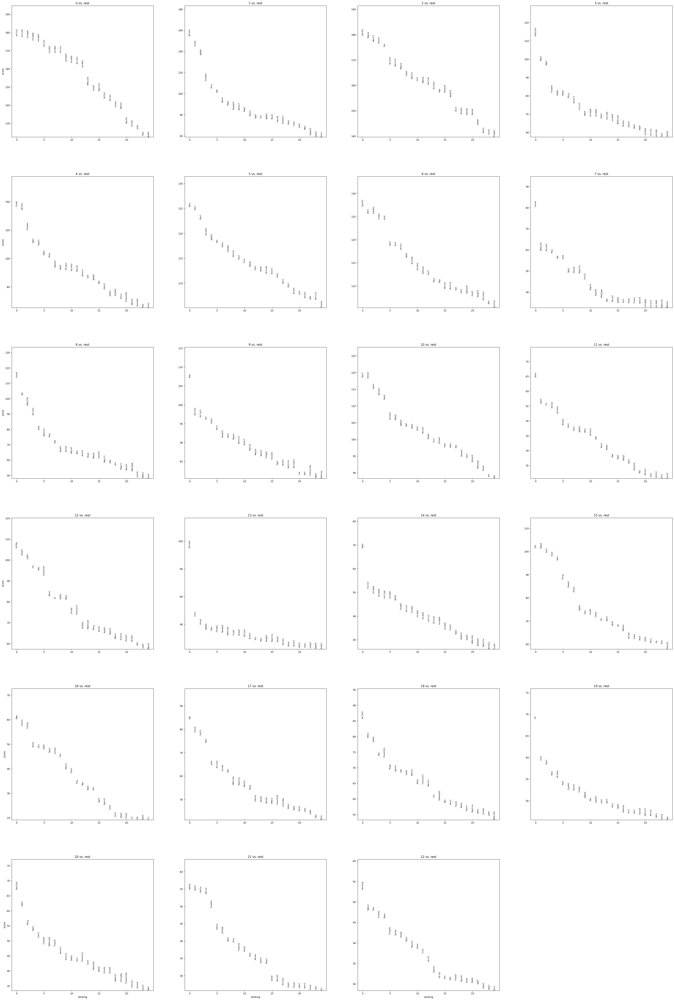

In [40]:
sc.tl.rank_genes_groups(ad, 'spatial_domains', method='wilcoxon', use_raw=True)
sc.pl.rank_genes_groups(ad, n_genes=25, sharey=False)

# End of Kidney tutorial
## See below for examples on brain analysis 
  
# _

## Spatial deconvolution

In order to better annotate barcoded spots and identify the mix of cell populations present in each spot, we 
map cell-type labels from already annotated `scRNA-seq` datasets to the spatial data with spatial deconvolution.
Spatial deconvolution aims to identify the propotions of cell types in each spatial location using `scRNA-seq` as reference.

In this notebook, we train a simple logistic regression classifier with L1 penalty to transfer the label from `scRNA-seq` to spatial data.

There exist more advanced method in literature to do spatial deconvolution, but often demand substantial computational resources or the use of gpus. Here are some examples:
- Tangram ([Biancalani et al., 2021](https://doi.org/10.1038/s41592-021-01264-7))
- Stereoscope ([Andersson et al., 2020](https://doi.org/10.1038/s42003-020-01247-y))
- DestVI ([Lopez et al., 2022](https://doi.org/10.1038/s41587-022-01272-8))
- RCTD ([Cable et al., 2022](https://doi.org/10.1038/s41587-021-00830-w))
- SPOTlight ([Elosua-Bayes et al., 2021](https://doi.org/10.1093/nar/gkab043))
- Cell2Location ([Kleshchevnikov et al., 2022](https://doi.org/10.1038/s41587-021-01139-4))

We first load `scRNA-seq` mouse brain reference dataset from ([Kleshchevnikov et al., 2022](https://doi.org/10.1038/s41587-021-01139-4)), and preprocess the data.

In [95]:
adata_sc = sc.read('/mnt/storage/nhecker/data/spatial/simple_Kleshchevnikov_snRNA_brain_slice_8_All.h5ad')
adata_sc

AnnData object with n_obs × n_vars = 40238 × 25128
    obs: 'BRAIN_cell_type', 'ClusterID', 'Kleshchevnikov_cell_type'

In [96]:
# Normalization of scRNA-seq reference
sc.pp.normalize_total(adata_sc)
sc.pp.log1p(adata_sc)

In [97]:
sc.pp.neighbors(adata_sc)
sc.tl.umap(adata_sc)

         Falling back to preprocessing with `sc.pp.pca` and default params.


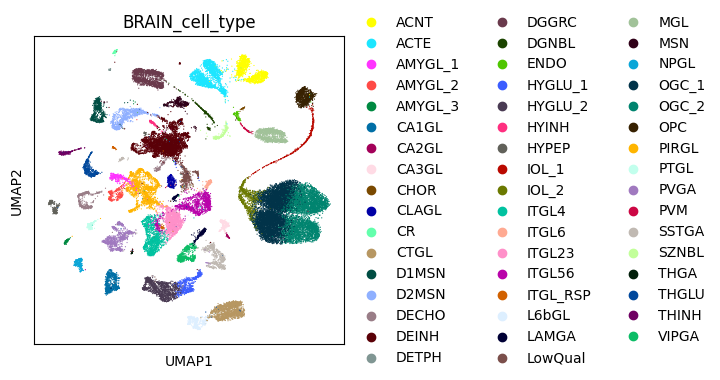

In [98]:
sc.pl.umap(adata_sc, color='BRAIN_cell_type')

### Cell-type annotations

| Name    | Description                                      | Location                                      |
|---------|--------------------------------------------------|-----------------------------------------------|
| ACNT    | Non-telencephalon astrocytes                     | Hypothalamus, Thalamus                        |
| ACTE    | Telencephalon astrocytes                         | Cortex, Hippocampus, Striatum, Amygdala       |
| AMYGL   | Excitatory neurons, amygdala                     | Amygdala                                      |
| CA1GL   | Excitatory neurons, hippocampus CA1              | Hippocampus CA1                               |
| CA2GL   | Excitatory neurons, hippocampus CA2              | Hippocampus CA2                               |
| CA3GL   | Excitatory neurons, hippocampus CA3              | Hippocampus CA3                               |
| CHOR    | Chorid plexus epithelial cells                   | Thalamus                                      |
| CLAGL   | Excitatory neurons, claustrum                    | Claustrum (Between cortical and sub-cortical areas) |
| CR      | Cajal-Retzius cells, hippocampus                 | Hippocampus, dentate gyrus                    |
| CTGL    | Corticothalamic neurons, cortex L6               | Cortex L6                                     |
| D1MSN   | D1 medium spiny neurons, striatum                | Striatum                                      |
| D2MSN   | D2 medium spiny neurons, striatum                | Striatum                                      |
| DECHO   | Diencephalon cholinergic neurons                 | Hypothalamus, Thalamus                        |
| DEINH   | Diencephalon inhibitory neurons                  | Hypothalamus, Thalamus                        |
| DETPH   | Neuroblast-like, habenula                        | Thalamus                                      |
| DGGRC   | Dentate gyrus granule cells                      | Hippocampus, dentate gyrus                    |
| DGNBL   | Dentate gyrus granule cell neuroblasts           | Hippocampus, dentate gyrus                    |
| ENDO    | Endothelial cells                                | -                                           |
| HYGLU   | Excitatory neurons, hypothalamus                 | Hypothalamus                                  |
| HYINH   | Inhibitory neurons, hypothalamus                 | Hypothalamus                                  |
| HYPEP   | Peptidergic neurons, hypothalamus                | Hypothalamus                                  |
| IOL     | Intermediate Oligodendrocytes                    | All, mostly in white matter                   |
| ITGL_RSP| Excitatory neurons, retrosplinial cortex         | Retrosplenial cortex                          |
| ITGL23  | Intratelencephalic excitatory neurons, cortex L23 | Cortex L23                                    |
| ITGL4   | Intratelencephalic excitatory neurons, cortex L4  | Cortex L4                                     |
| ITGL56  | Intratelencephalic excitatory neurons, cortex L56 | Cortex L56                                    |
| ITGL6   | Intratelencephalic excitatory neurons, cortex L6  | Cortex L6                                     |
| L6bGL   | Intratelencephalic excitatory neurons, cortex L6b | Cortex L6b                                    |
| LAMGA   | Lateral Ganglionic Eminence interneurons (Lamp5)  | Cortex, upper layers                          |
| MGL     | Microglia                                        | -                                       |
| MSN     | Patch/Matrix neurons, striatum                   | Striatum                                      |
| NPGL    | Near-projecting excitatory neurons, cortex L5    | Cortex L5                                     |
| OGC     | Oligodendrocytes                                 | All, mostly in white matter                   |
| OPC     | Oligodendrocyte precursors                       | All, mostly in white matter                   |
| PIRGL   | Excitatory neurons, piriform cortex              | Piriform cortex                               |
| PTGL    | Pyramidal tract excitatory neurons, cortex L5    | Cortex L5                                     |
| PVGA    | Medial Ganglionic Eminence interneurons (Pvalb)  | Cortex, lower layers                          |
| PVM     | Perivascular macrophages                         | -                                       |
| SSTGA   | Medial Ganglionic Eminence interneurons (Sst)    | Cortex, lower layers                          |
| SZNBL   | Neuronal intermediate progenitor cells           | Striatum, dentate gyrus                       |
| THGA    | Dopaminergic interneurons                        | -                                             |
| THGLU   | Excitatory neurons, thalamus                     | Thalamus                                      |
| THINH   | Inhibitory neurons, thalamus                     | Thalamus                                      |
| VIPGA   | Lateral Ganglionic Eminence interneurons (Vip)   | Cortex, upper layers                          |


We first filter out low quality cells (`LowQual`) from the scRNA-seq reference

In [99]:
adata_sc = adata_sc[adata_sc.obs.BRAIN_cell_type!='LowQual']

In [100]:
adata_sc.raw = adata_sc
sc.pp.scale(adata_sc)

We subset the genes to the ones shared between the two datasets

In [101]:
adata_sc = adata_sc[:, adata_sc.var_names.isin(hd.var_names)]
adata_sc

View of AnnData object with n_obs × n_vars = 39744 × 12843
    obs: 'BRAIN_cell_type', 'ClusterID', 'Kleshchevnikov_cell_type'
    var: 'mean', 'std'
    uns: 'log1p', 'neighbors', 'umap', 'BRAIN_cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

We then train a logistic regression model with L1 penalty to classify cell-type from scRNA-seq gene expression data. (This step takes few minutes to run!)

In [102]:
from sklearn.linear_model import LogisticRegression

lasso_classifier = LogisticRegression(penalty='l1', solver='liblinear')
lasso_classifier.fit(adata_sc.X, adata_sc.obs.BRAIN_cell_type.values)

LogisticRegression(penalty='l1', solver='liblinear')

We used the trained classifier to predict cell-type labels and cell-type probabilities for the 10X Visium data (first restoring the log-normalized values in our AnnData object)

In [103]:
y_pred = lasso_classifier.predict(hd[:, adata_sc.var_names].X)
y_probs = lasso_classifier.predict_proba(hd[:, adata_sc.var_names].X)

In [104]:
cp_df = pd.DataFrame(
    y_probs, columns=np.sort(adata_sc.obs.BRAIN_cell_type.unique())
)

cp_df.index = hd.obs.index

In [105]:
hd.obs['sc_annot'] = y_pred

In [106]:
adata_transfer = hd.copy()
adata_transfer.obs = pd.concat(
    [hd.obs, cp_df], axis=1
)

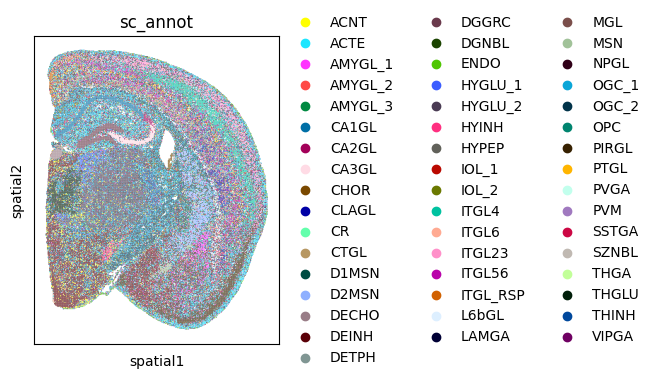

In [107]:
sc.pl.spatial(
    hd,
    color=['sc_annot'],
    spot_size=1,
)

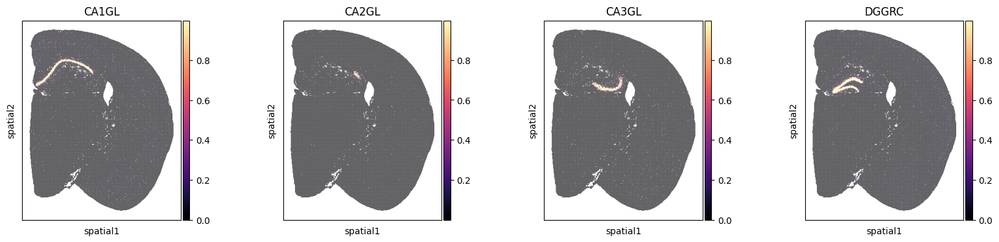

In [108]:
sc.pl.spatial(
    adata_transfer,
    color=['CA1GL', 'CA2GL', 'CA3GL', 'DGGRC'],
    spot_size=1,
    cmap='magma'
)

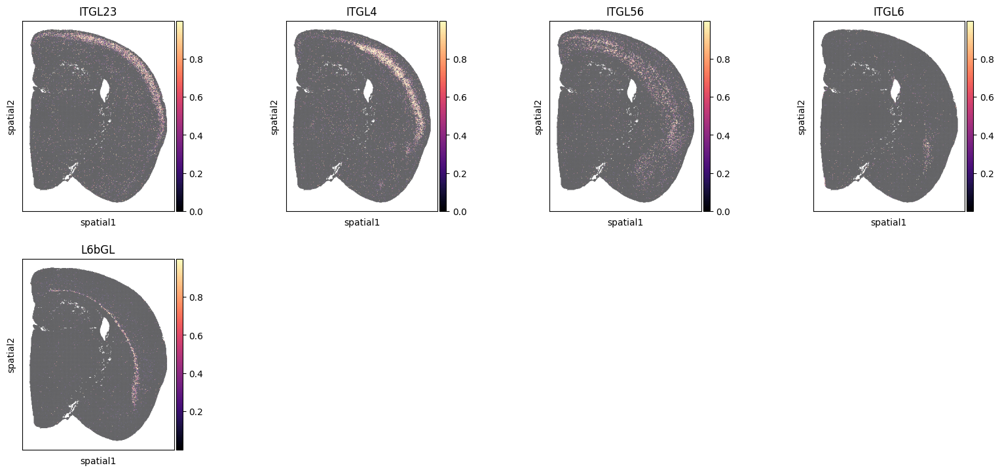

In [109]:
sc.pl.spatial(
    adata_transfer,
    color=['ITGL23', 'ITGL4', 'ITGL56', 'ITGL6', 'L6bGL'],
    spot_size=1,
    cmap='magma'
)

## Neighborhood enrichment
After mapping cell-type distributions in space, we can quantify if they are spatially co-localized by **Neighborhood enrichment analysis**. Cellular neighborhood analysis is a good starting point to understand how different cell-type spatially iteract and to find initial candidates for cell-cell communication based on spatial proximity.

In [110]:
sq.gr.nhood_enrichment(hd, cluster_key="sc_annot")

  0%|          | 0/1000 [00:00<?, ?/s]

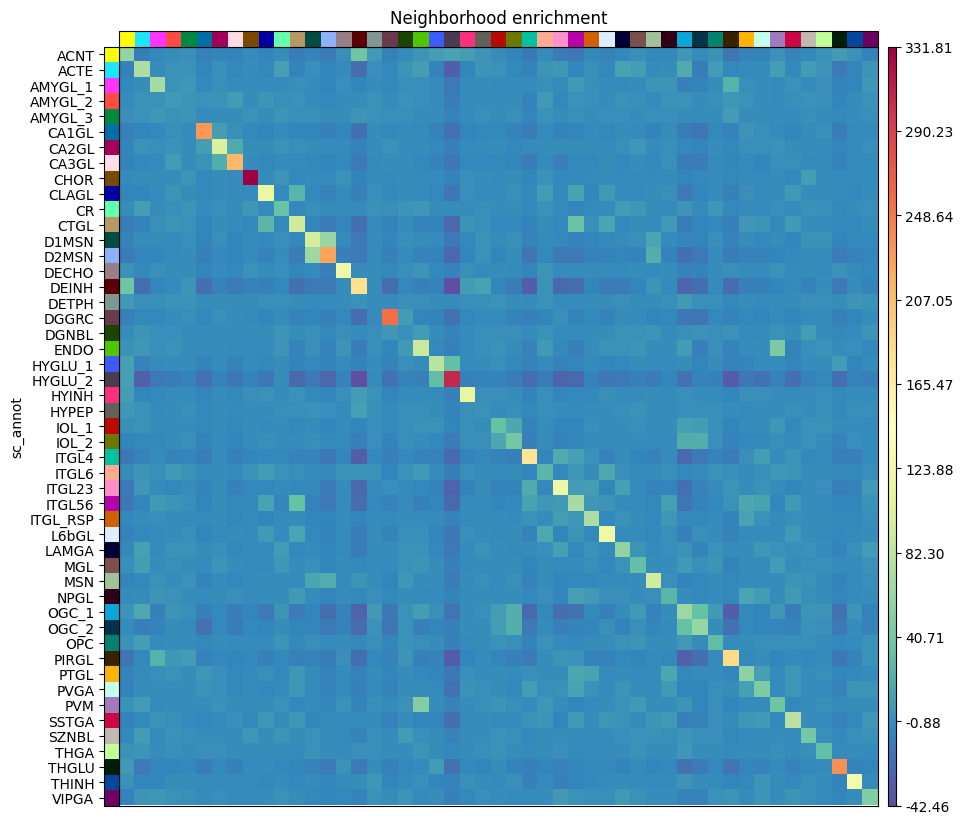

In [111]:
sq.pl.nhood_enrichment(hd, cluster_key="sc_annot" ,figsize=(8,8), cmap='Spectral_r')

Plot the spatial distribution of two neighboring cell types

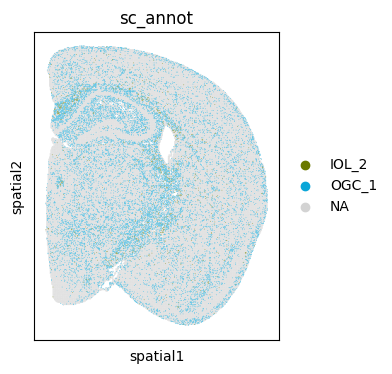

In [112]:
sc.pl.spatial(hd, color=['sc_annot'], groups=['OGC_1', 'IOL_2'], spot_size=1)

# _
# Image based spatial transcriptomics

## Imports

In [17]:
import skimage as ski
from scipy import ndimage as ndi
import squidpy as sq
import scanpy as sc
import anndata
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from skimage.segmentation import expand_labels

data_folder = '/mnt/storage/nhecker/data/spatial/MERFISH/'

print(sc.__version__, sq.__version__, anndata.__version__)

1.9.1 1.2.2 0.8.0


## Segmentation
For image based spatial transcriptomics we need to assign the detected RNA molecules to individual cells. This is usually done through image segmentation on stained tissue. The most common staining is a nuclei staining with the dyes DAPI, Hoechst or Propidium Iodide. Sometimes the cytoplasm is labeled by a probe for the Poly-A tails of mRNA, or the membranes enveloping each cells are stained.  
  
However this is done, segmentation is a hard task and errors are quickly made.  
Here we will try to segment an image of nuclei. 

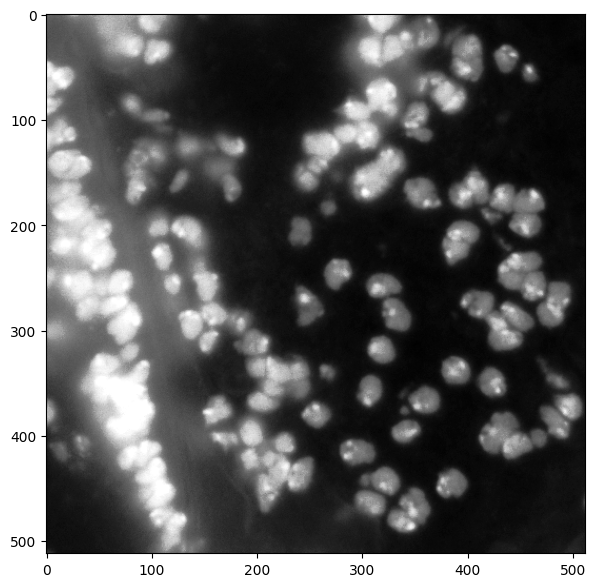

In [118]:
img = ski.io.imread(data_folder + 'Nuclei_rescaled.tif')

plt.figure(figsize=(7,7))
plt.imshow(img, cmap='Greys_r')

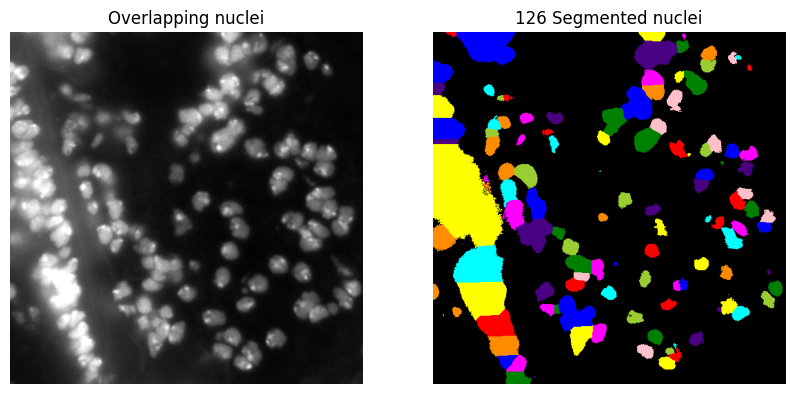

In [119]:
#Find the threshold and apply to image
threshold = ski.filters.threshold_otsu(img)
cells = img > threshold

#Perform a distance transform
distance = ndi.distance_transform_edt(cells)

#Find local maxima as seeds for wathershed
local_max_coords = ski.feature.peak_local_max(distance, min_distance=5, exclude_border=False)
local_max_mask = np.zeros(distance.shape, dtype=bool)
local_max_mask[tuple(local_max_coords.T)] = True
markers = ski.measure.label(local_max_mask)

#Perform segmenation
segmented_cells = ski.segmentation.watershed(-distance, markers, mask=cells)

#Visualization
fig, axes = plt.subplots(ncols=2, figsize=(10, 5))
ax0, ax1 = axes
ax0.imshow(img, cmap='gray')
ax0.set_title('Overlapping nuclei')
ax0.set_axis_off()
ax1.imshow(ski.color.label2rgb(segmented_cells, bg_label=0))
n_cells = len(np.unique(segmented_cells)) - 1
ax1.set_title(f'{n_cells} Segmented nuclei')
ax1.set_axis_off()

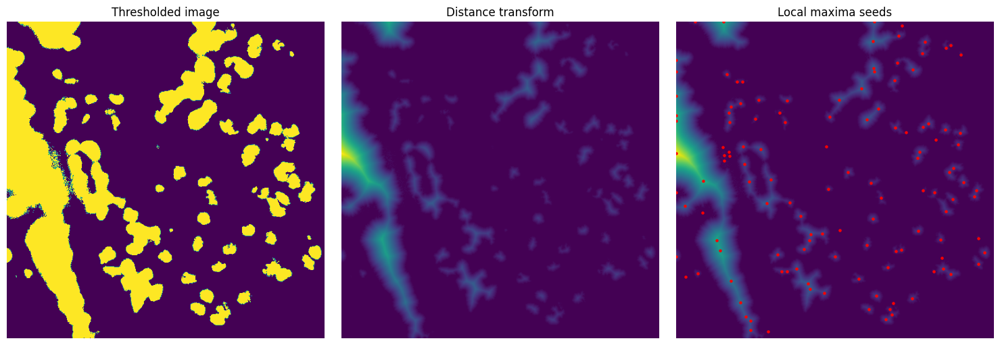

In [4]:
fig, axes = plt.subplots(ncols=3, figsize=(15,5))
ax0, ax1, ax2 = axes

ax0.imshow(cells)
ax0.set_axis_off()
ax0.set_title('Thresholded image')

ax1.imshow(distance)
ax1.set_axis_off()
ax1.set_title('Distance transform')

ax2.imshow(distance)
non_zero_indices = np.nonzero(markers)
xy_maxima = np.array(list(zip(non_zero_indices[0], non_zero_indices[1])))
ax2.scatter(xy_maxima[:,1], xy_maxima[:,0], s=5, c='r')
ax2.set_axis_off()
ax2.set_title('Local maxima seeds')
plt.tight_layout()

### Watershed
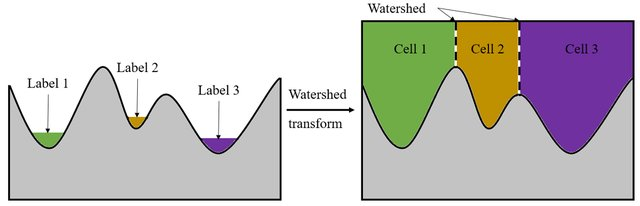
Adapted from: http://dx.doi.org/10.3390/s21041365

## Cellpose
More modern ways of doing segmenation uses Neural Networks such as:
- Cellpose [paper](https://www.nature.com/articles/s41592-020-01018-x)
- Stardist [paper](https://arxiv.org/abs/1806.03535)
  
  
## Website demo
https://www.cellpose.org/

# Spatial analysis of MERFISH data
In this part we will take a closer look at MERFISH data from the mouse brain.  
This dataset measured 1122 genes in multiple sections of the mouse brain, with sub-cellular resolution.
  
The data comes from this paper:  
Zhang, M., Pan, X., Jung, W. et al. Molecularly defined and spatially resolved cell atlas of the whole mouse brain. Nature 624, 343–354 (2023). https://doi.org/10.1038/s41586-023-06808-9  
Link: https://www.nature.com/articles/s41586-023-06808-9
  
The data was downloaded from the [CELLxGENE](https://cellxgene.cziscience.com/) database.  
Downloaded from: https://cellxgene.cziscience.com/collections/0cca8620-8dee-45d0-aef5-23f032a5cf09
 
## Plot of all cells in the dataset:
  
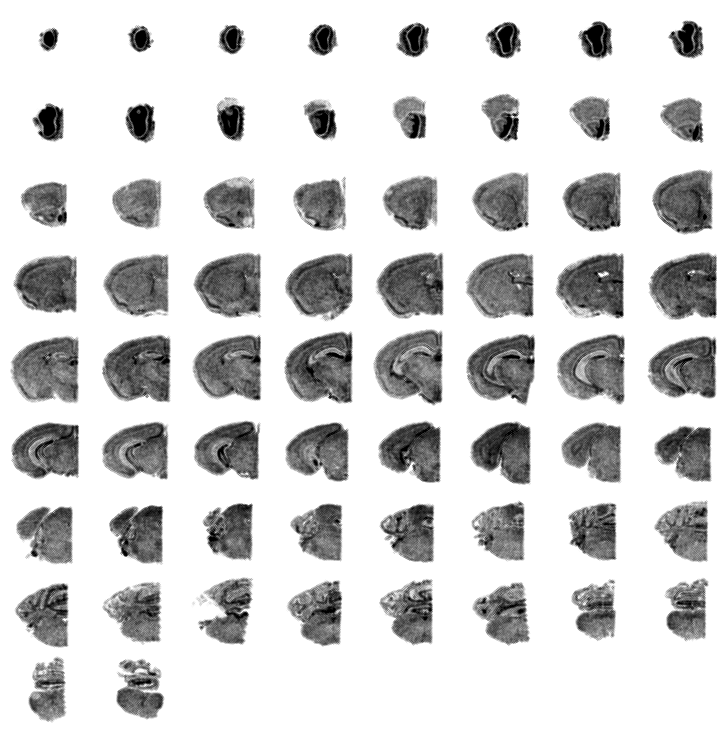
  
Because the dataset is rather large with almost 2M cells, we have downsized the dataset to a single section.

## Load data
The data is in the [anndata](https://anndata.readthedocs.io/en/latest/) format.
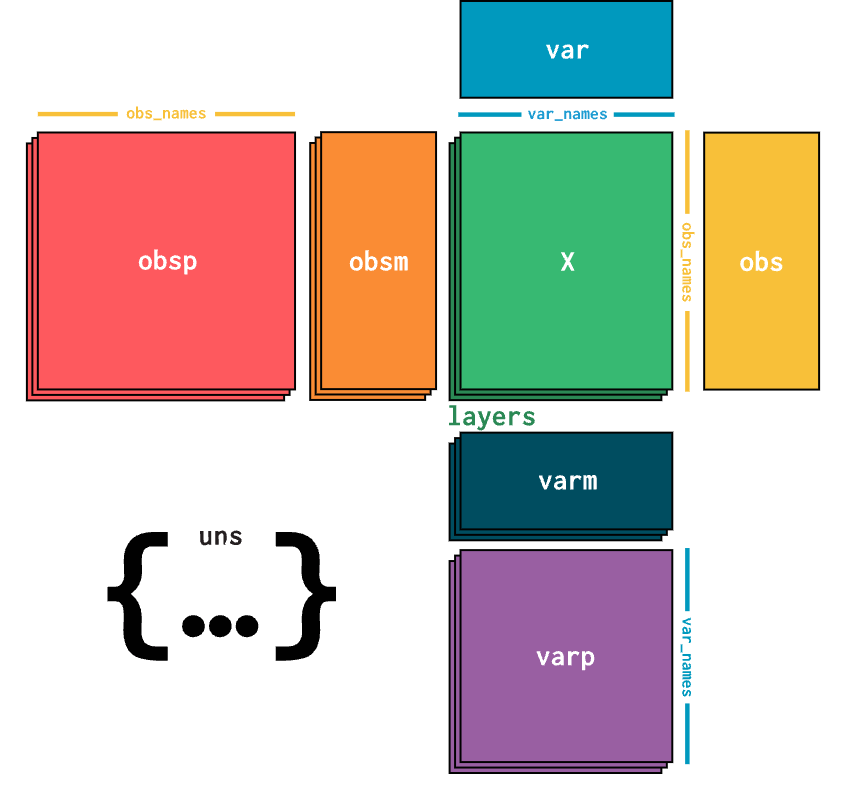

In [5]:
# Load the demo Anndata of the MERFISH data
adata =  anndata.read_h5ad(data_folder + 'WB_MERFISH_animal2_coronal_Zhang_2023_downsample.h5ad')#, backed='r')

# Show the content of te Anndata object
adata

AnnData object with n_obs × n_vars = 37816 × 1122
    obs: 'organism_ontology_term_id', 'donor_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'cell_type_ontology_term_id', 'assay_ontology_term_id', 'cluster_id_transfer', 'subclass_transfer', 'cluster_confidence_score', 'subclass_confidence_score', 'high_quality_transfer', 'major_brain_region', 'ccf_region_name', 'brain_section_label', 'tissue_type', 'is_primary_data', 'cell_type', 'assay', 'organism', 'sex', 'tissue', 'development_stage', 'observation_joinid'
    var: 'gene_name', 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 'feature_length'
    uns: 'citation', 'schema_reference', 'schema_version', 'title'
    obsm: 'X_CCF', 'X_spatial_coords', 'X_umap'

In [120]:
adata.X

<37816x1122 sparse matrix of type '<class 'numpy.float32'>'
	with 2323782 stored elements in Compressed Sparse Row format>

In [7]:
# Explore the metadata
print(f'n observations: {adata.shape[0]}, n variables: {adata.shape[1]}')

print('\nObservation or cells: obs')
for k in adata.obs.keys():
    print(f'    {k:30}: {adata.obs[k][0]}')

print('\nVariables or genes: var')
for k in adata.var.keys():
    print(f'    {k:30}: {adata.var[k][0]}')
    
print('\nObservation unstructured: obsm')
for k in adata.obsm.keys():
    print(f'    {k:30}: {adata.obsm[k][0]}')

n observations: 37816, n variables: 1122

Observation or cells: obs
    organism_ontology_term_id     : NCBITaxon:10090
    donor_id                      : C57BL6J-2
    sex_ontology_term_id          : PATO:0000384
    tissue_ontology_term_id       : UBERON:0000955
    cell_type_ontology_term_id    : CL:0000617
    assay_ontology_term_id        : EFO:0008992
    cluster_id_transfer           : 1961
    subclass_transfer             : PVR Six3 Sox3 Gaba
    cluster_confidence_score      : 0.2628556666725655
    subclass_confidence_score     : 0.7160287990855584
    high_quality_transfer         : False
    major_brain_region            : nan
    ccf_region_name               : nan
    brain_section_label           : C57BL6J-2.037
    tissue_type                   : tissue
    is_primary_data               : True
    cell_type                     : GABAergic neuron
    assay                         : MERFISH
    organism                      : Mus musculus
    sex                        

## Explore dataset

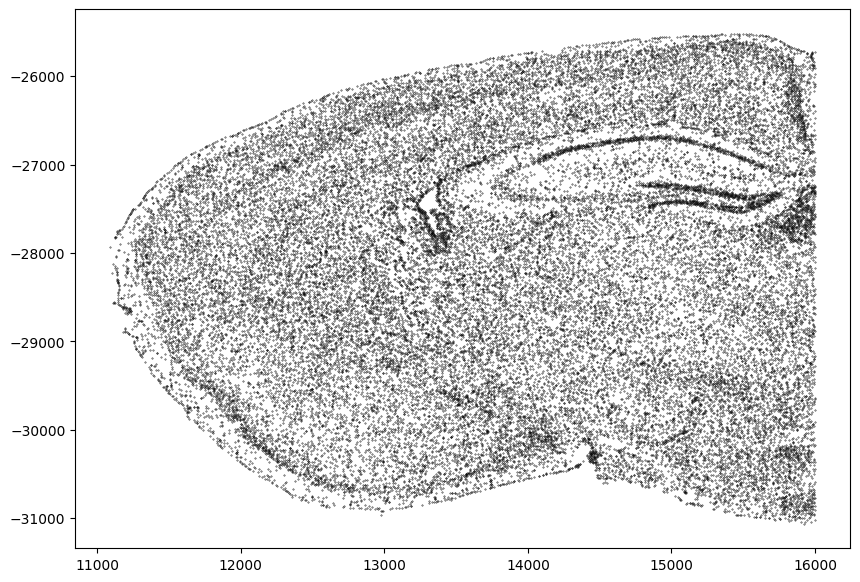

In [8]:
# Manual plotting using matplotlib
fig, ax = plt.subplots(figsize=(10,7))

xy = adata.obsm['X_spatial_coords']

ax.scatter(xy[:,0], xy[:,1], s=0.1, c='black')

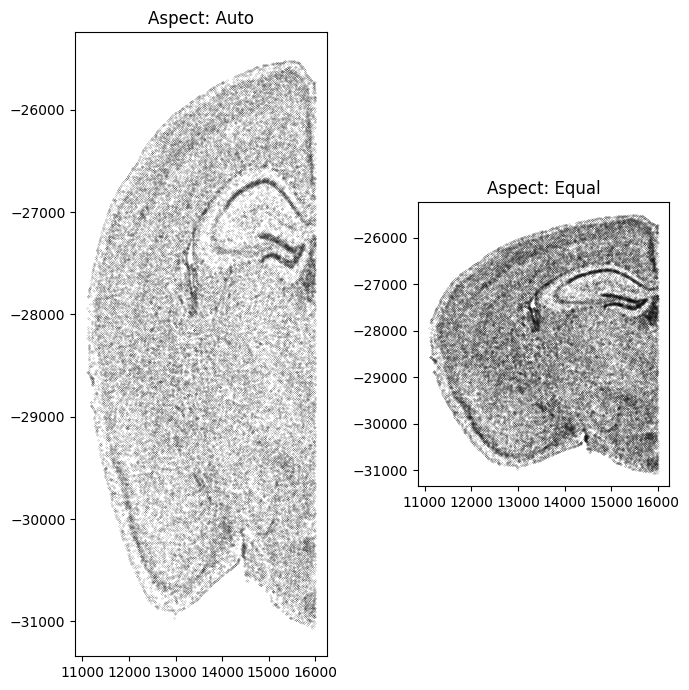

In [18]:
# Importance of setting the aspect to equal
fig, axes = plt.subplots(figsize=(7,7), ncols=2)
ax0, ax1 = axes

ax0.scatter(xy[:,0], xy[:,1], s=0.01, c='black')
ax0.set_title('Aspect: Auto')

ax1.scatter(xy[:,0], xy[:,1], s=0.01, c='black')
ax1.set_aspect('equal')
ax1.set_title('Aspect: Equal')

plt.tight_layout()

# Plot gene expression

In [12]:
# Make dictionary linking gene name to Ensembl gene ID
gene_to_ensembl = dict(zip(adata.var['gene_name'], adata.var_names))

# Reverse the dictionary
ensembl_to_gene = dict([v,k] for k,v in gene_to_ensembl.items())

# Show dictionary content
list(gene_to_ensembl.items())[:10]

[('Htr7', 'ENSMUSG00000024798'),
 ('Gzmk', 'ENSMUSG00000042385'),
 ('Arhgap36', 'ENSMUSG00000036198'),
 ('Sema3c', 'ENSMUSG00000028780'),
 ('Rxrg', 'ENSMUSG00000015843'),
 ('Itga8', 'ENSMUSG00000026768'),
 ('Glp2r', 'ENSMUSG00000049928'),
 ('Ramp3', 'ENSMUSG00000041046'),
 ('Car12', 'ENSMUSG00000032373'),
 ('Chn2', 'ENSMUSG00000004633')]

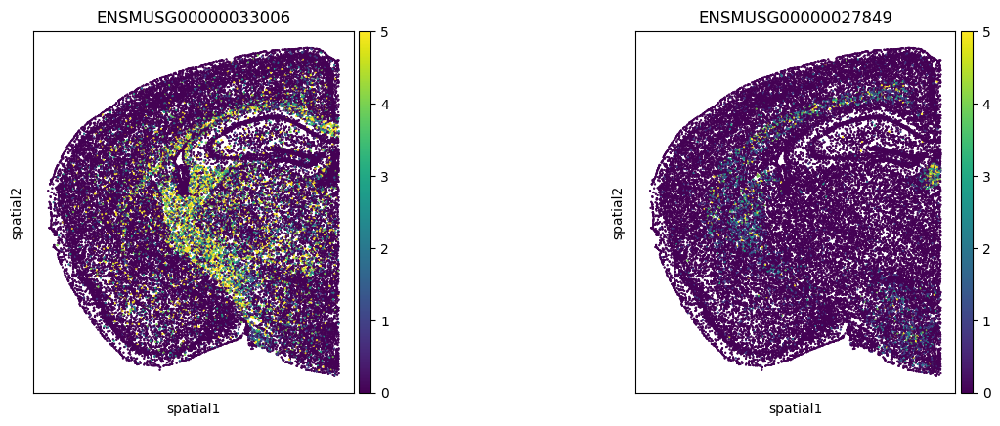

In [13]:
# Renaming the coordinates to the standard "X_spatial"
adata.obsm['spatial'] = adata.obsm['X_spatial_coords'] * np.array([1,-1]) #Flip Y axis for plotting

# Translate gene names to Ensemble gene IDs
genes_to_plot = [gene_to_ensembl[i] for i in ['Sox10', 'Syt6']]

# Use squidpy for easy plotting
sq.pl.spatial_scatter(adata, shape=None, color=genes_to_plot, size=1, vmax=5)

## QC

### Cell size
If you work with segmented data it is a good idea to remove segmenation errors. These could be small objects in the image that are not cells, or multiple cells that are seens as one cell by the segmentation algorithm.  
  
Unfortunately there is no cell size data available for our dataset, so we will use use segmentation results as example.

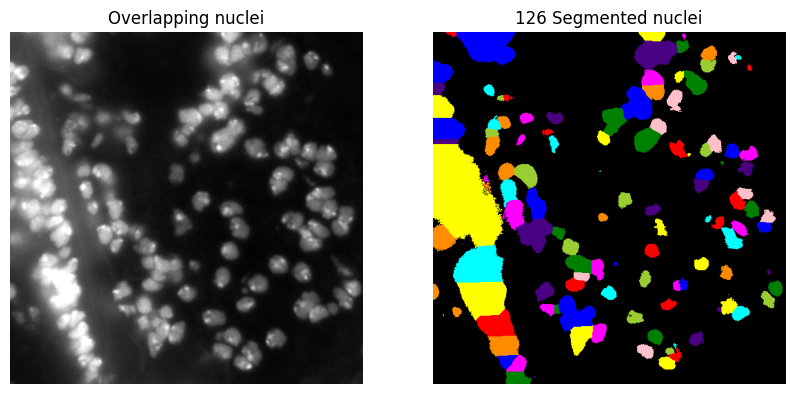

In [14]:
# Filtering on cell size can remove segmentation artefacts
fig, axes = plt.subplots(ncols=2, figsize=(10, 5))
ax0, ax1 = axes
ax0.imshow(img, cmap='gray')
ax0.set_title('Overlapping nuclei')
ax0.set_axis_off()
ax1.imshow(ski.color.label2rgb(segmented_cells, bg_label=0))
n_cells = len(np.unique(segmented_cells)) - 1
ax1.set_title(f'{n_cells} Segmented nuclei')
ax1.set_axis_off()

Text(0.5, 0, 'N pixels')

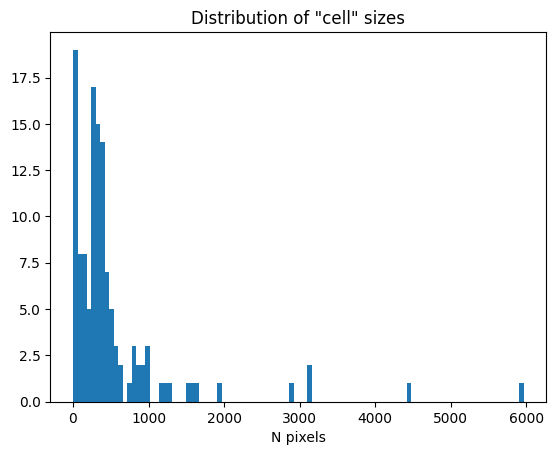

In [15]:
u,c = np.unique(segmented_cells, return_counts=True)
u = u[1:] #Remove background
c = c[1:] #Remove background
plt.figure()
plt.hist(c, bins=100);
plt.title('Distribution of "cell" sizes')
plt.xlabel('N pixels')

In this example the pixel size is 0.18 um.  
A typical cell has a nuclear diameter of 3-7 um.   
That means an area of:   
- pi * 1.5^2 = 7.07 um2  
- pi * 3.5^2 = 38.48 um2

Pixel area = 0.18 * 0.18 = 0.0324 um2  
  
Small nuclei: 7.07 / 0.0324 = 218 pixels  
large nuclei: 19.63 / 0.0324 = 1188 pixels  

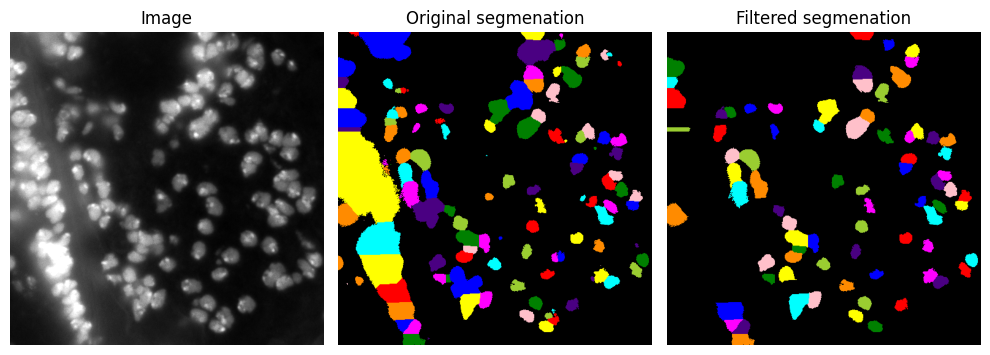

In [16]:
# Filter out labels that have to few or too many pixels
filt = (c > 218) & (c < 1188)
valid_labels = u[filt]

# Visualize
valid_label_mask = np.isin(segmented_cells, valid_labels)
final_mask = np.zeros_like(segmented_cells)
final_mask[valid_label_mask] = segmented_cells[valid_label_mask]

fig, axes = plt.subplots(figsize=(10,5), ncols=3)
ax0, ax1, ax2 = axes

ax0.imshow(img, cmap='gray')
ax0.set_title('Image')
ax1.imshow(ski.color.label2rgb(segmented_cells, bg_label=0))
ax1.set_title('Original segmenation')
ax2.imshow(ski.color.label2rgb(final_mask, bg_label=0))
ax2.set_title('Filtered segmenation')

for ax in axes:
    ax.set_axis_off()
plt.tight_layout()

### Expanding the labels

Text(0.5, 1.0, 'Expanded')

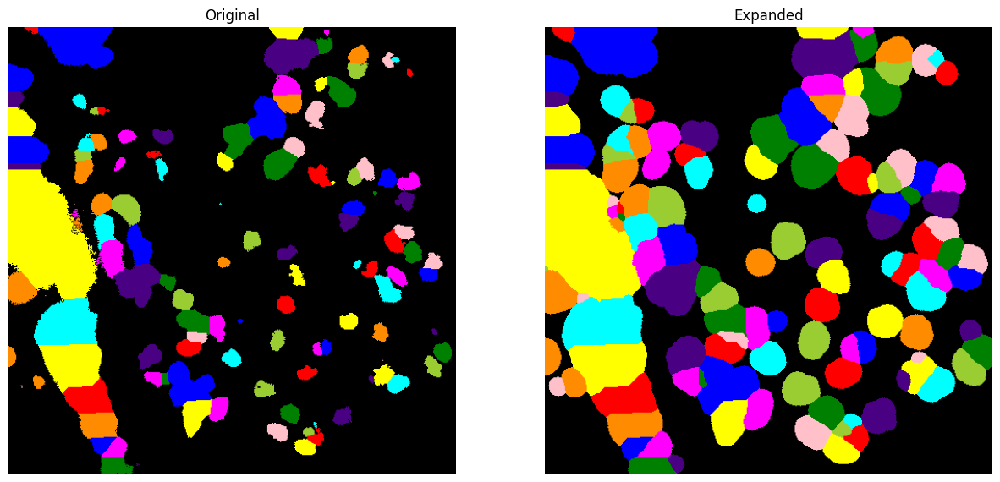

In [23]:
# Expanding the labels
fig, axes = plt.subplots(figsize=(15,7), ncols=2)
ax0, ax1 = axes
ax0.imshow(ski.color.label2rgb(segmented_cells, bg_label=0))
ax0.set_axis_off()
ax0.set_title('Original')

expanded = expand_labels(segmented_cells, distance=10)
ax1.imshow(ski.color.label2rgb(expanded, bg_label=0))
ax1.set_axis_off()
ax1.set_title('Expanded')

### Total counts
From the paper: 
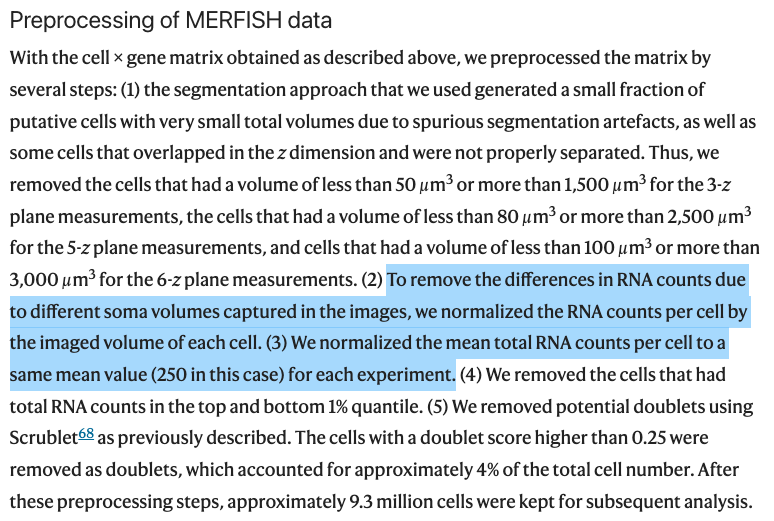

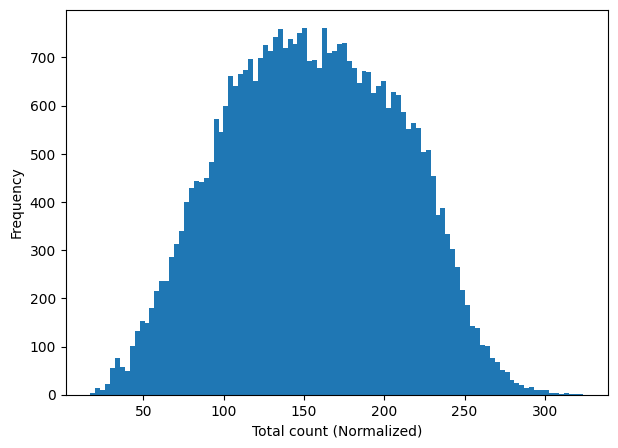

In [24]:
total_cell_counts = np.sum(adata.X.toarray(), axis=1)

plt.figure(figsize=(7,5))
plt.hist(total_cell_counts, bins=100)
plt.ylabel('Frequency')
plt.xlabel('Total count (Normalized)');

### Filter genes

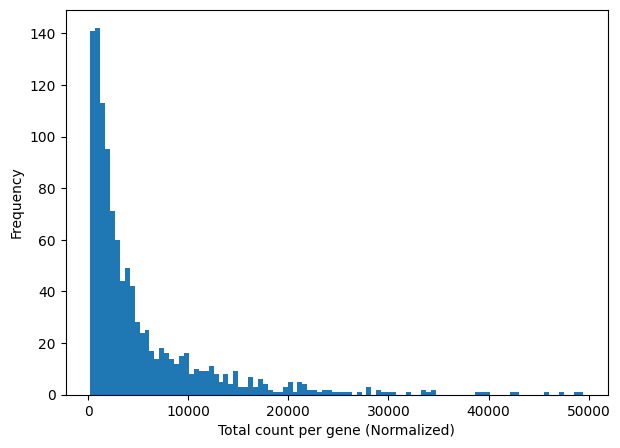

In [25]:
total_gene_counts = np.sum(adata.X.toarray(), axis=0)

plt.figure(figsize=(7,5))
plt.hist(total_gene_counts, bins=100)
plt.ylabel('Frequency')
plt.xlabel('Total count per gene (Normalized)');

# Normalization

In [27]:
#Total count normalization has already been performed

# Log normalization
sc.pp.log1p(adata)

# Dimensionality reduction: PCA

In [28]:
# Calculate PCA
sc.pp.pca(adata)

In [29]:
adata

AnnData object with n_obs × n_vars = 37816 × 1122
    obs: 'organism_ontology_term_id', 'donor_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'cell_type_ontology_term_id', 'assay_ontology_term_id', 'cluster_id_transfer', 'subclass_transfer', 'cluster_confidence_score', 'subclass_confidence_score', 'high_quality_transfer', 'major_brain_region', 'ccf_region_name', 'brain_section_label', 'tissue_type', 'is_primary_data', 'cell_type', 'assay', 'organism', 'sex', 'tissue', 'development_stage', 'observation_joinid'
    var: 'gene_name', 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 'feature_length'
    uns: 'citation', 'schema_reference', 'schema_version', 'title', 'log1p', 'pca'
    obsm: 'X_CCF', 'X_spatial_coords', 'X_umap', 'spatial', 'X_pca'
    varm: 'PCs'

In [30]:
adata.obsm['X_pca'].shape

(37816, 50)

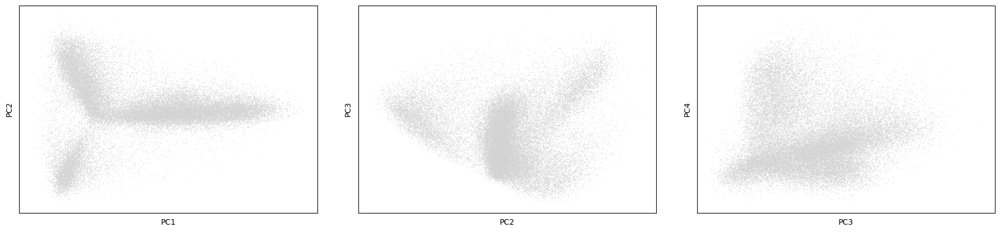

In [31]:
# Plot PCA compontents
sc.pl.pca(adata, components=['1,2', '2,3', '3,4'])

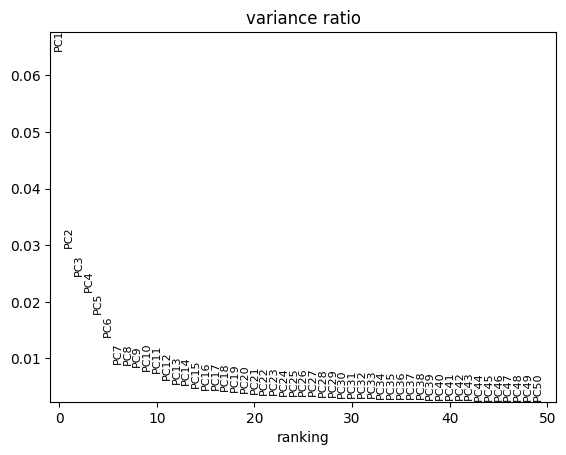

In [32]:
# Check explained variance
sc.pl.pca_variance_ratio(adata, n_pcs=50, log=False)

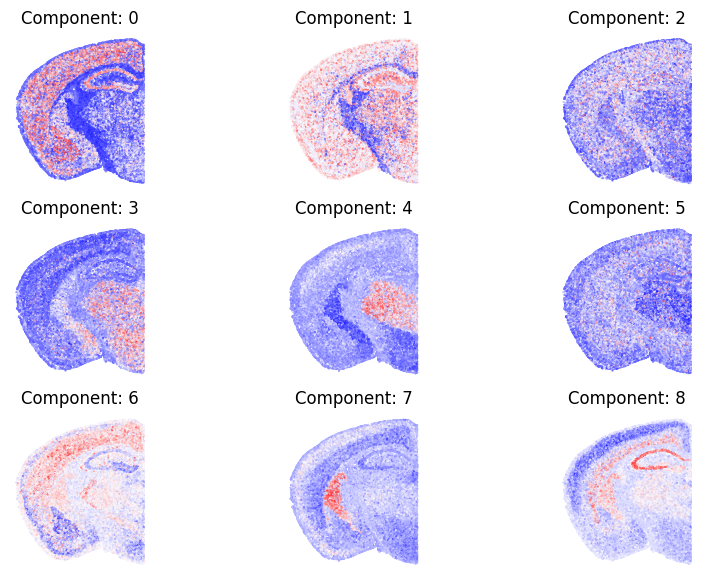

In [121]:
# Plot PCA components spatially
fig, axes = plt.subplots(figsize=(10,7), ncols=3, nrows=3)
for i in range(9):
    ax = axes[int(i/3), i%3]
    ax.scatter(xy[:,0], xy[:,1], s=0.1, c=adata.obsm['X_pca'][:,i], cmap='bwr')
    ax.set_title(f'Component: {i}')
    ax.set_aspect('equal')
    ax.set_axis_off()

## Embedding

In [25]:
#Calculate UMAP

# sc.umap(adata)

In [35]:
adata

AnnData object with n_obs × n_vars = 37816 × 1122
    obs: 'organism_ontology_term_id', 'donor_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'cell_type_ontology_term_id', 'assay_ontology_term_id', 'cluster_id_transfer', 'subclass_transfer', 'cluster_confidence_score', 'subclass_confidence_score', 'high_quality_transfer', 'major_brain_region', 'ccf_region_name', 'brain_section_label', 'tissue_type', 'is_primary_data', 'cell_type', 'assay', 'organism', 'sex', 'tissue', 'development_stage', 'observation_joinid'
    var: 'gene_name', 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 'feature_length'
    uns: 'citation', 'schema_reference', 'schema_version', 'title', 'log1p', 'pca'
    obsm: 'X_CCF', 'X_spatial_coords', 'X_umap', 'spatial', 'X_pca'
    varm: 'PCs'

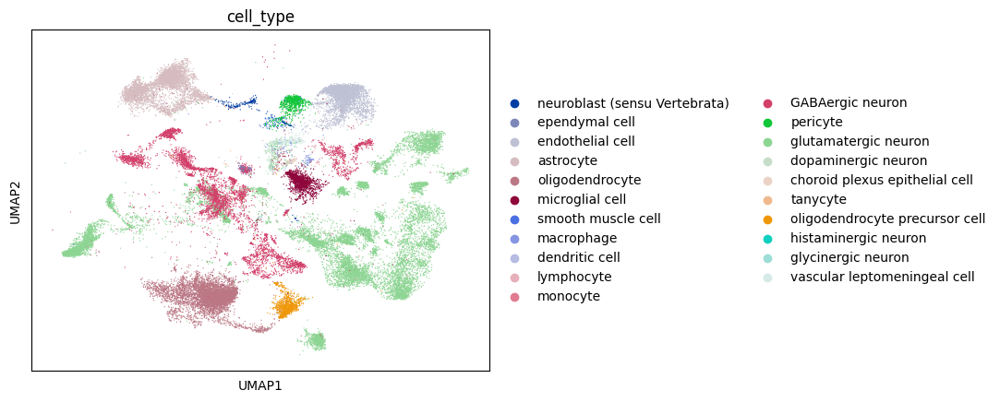

In [36]:
# Use umap that is already calculated with 
sc.pl.umap(adata, color='cell_type')

In [37]:
#Andata uses categorical data types
adata.obs['cell_type']

105657335133713056406921838724118687644                GABAergic neuron
122436527870827938431159130160634971854                 oligodendrocyte
150251543924763785586958231487676461967                       astrocyte
17256072951405411941367950165751449341                  oligodendrocyte
222400447091267968594989329857703232307                       astrocyte
                                                       ...             
262856282210982823002155779332406149143                endothelial cell
43049552606897547591964916585997619054     vascular leptomeningeal cell
57738795839812488512974768176295083810             glutamatergic neuron
91845286178686818613761784978630327401                 endothelial cell
94263499768115909555951128366472998862     vascular leptomeningeal cell
Name: cell_type, Length: 37816, dtype: category
Categories (21, object): ['neuroblast (sensu Vertebrata)', 'ependymal cell', 'endothelial cell', 'astrocyte', ..., 'oligodendrocyte precursor cell', 'histaminer

In [38]:
adata.obs['cell_type'].cat.categories

Index(['neuroblast (sensu Vertebrata)', 'ependymal cell', 'endothelial cell',
       'astrocyte', 'oligodendrocyte', 'microglial cell', 'smooth muscle cell',
       'macrophage', 'dendritic cell', 'lymphocyte', 'monocyte',
       'GABAergic neuron', 'pericyte', 'glutamatergic neuron',
       'dopaminergic neuron', 'choroid plexus epithelial cell', 'tanycyte',
       'oligodendrocyte precursor cell', 'histaminergic neuron',
       'glycinergic neuron', 'vascular leptomeningeal cell'],
      dtype='object')

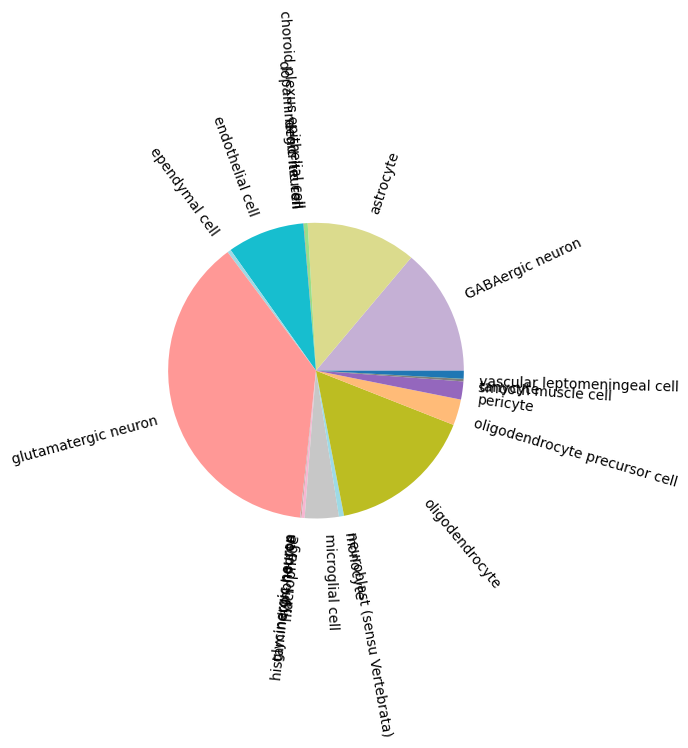

In [39]:
# Make some colors for the major cell types
cell_types = adata.obs['cell_type'].cat.categories
n_types = len(cell_types)
colors = [plt.cm.tab20_r(i/n_types) for i in np.arange(n_types)]
cell_type_color_dict = dict(zip(cell_types, colors))

# Make a pyplot of cell type abundance
u, c = np.unique(adata.obs['cell_type'], return_counts=True)

plt.pie(c, colors=[cell_type_color_dict[i] for i in u], labels=u, rotatelabels=True);

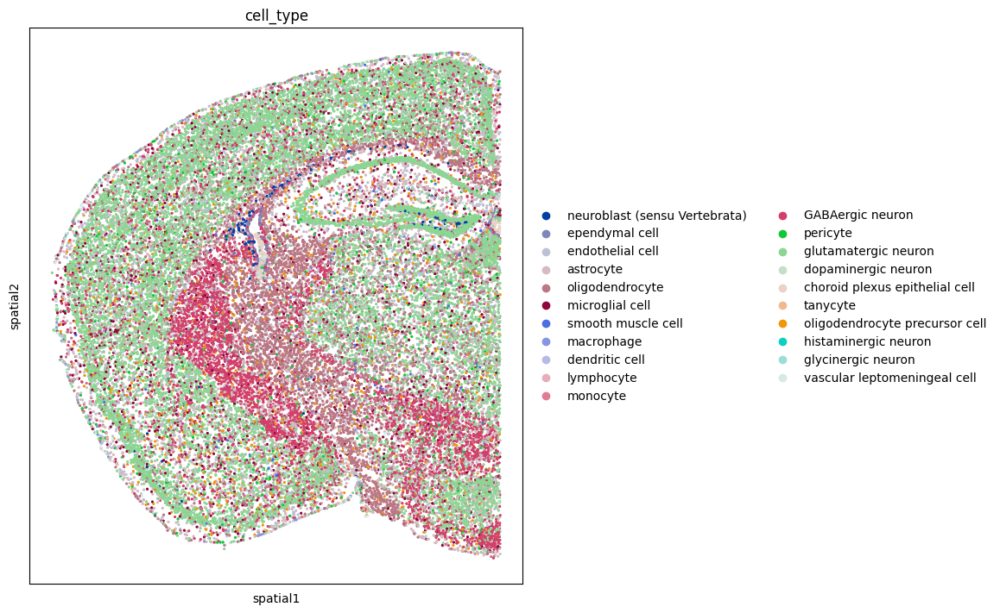

In [40]:
sq.pl.spatial_scatter(adata, shape=None, color='cell_type', size=5, figsize=(20,7))

## Clustering

In [41]:
# Takes 1 minute

# Calculate neighbours
sc.pp.neighbors(adata)

# Cluster data using Leiden clustering
sc.tl.leiden(adata, key_added = "leiden_1.0")

2024-10-07 18:14:17.031446: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/R/lib:/usr/local/lib:/usr/lib/x86_64-linux-gnu:/usr/lib/jvm/java-11-openjdk-amd64/lib/server:/.singularity.d/libs
2024-10-07 18:14:17.031485: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [42]:
adata

AnnData object with n_obs × n_vars = 37816 × 1122
    obs: 'organism_ontology_term_id', 'donor_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'cell_type_ontology_term_id', 'assay_ontology_term_id', 'cluster_id_transfer', 'subclass_transfer', 'cluster_confidence_score', 'subclass_confidence_score', 'high_quality_transfer', 'major_brain_region', 'ccf_region_name', 'brain_section_label', 'tissue_type', 'is_primary_data', 'cell_type', 'assay', 'organism', 'sex', 'tissue', 'development_stage', 'observation_joinid', 'leiden_1.0'
    var: 'gene_name', 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 'feature_length'
    uns: 'citation', 'schema_reference', 'schema_version', 'title', 'log1p', 'pca', 'cell_type_colors', 'neighbors', 'leiden'
    obsm: 'X_CCF', 'X_spatial_coords', 'X_umap', 'spatial', 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

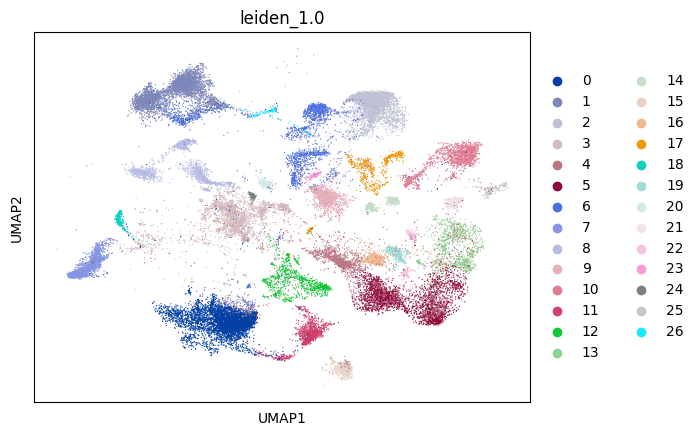

In [45]:
sc.pl.umap(adata, color='leiden_1.0')

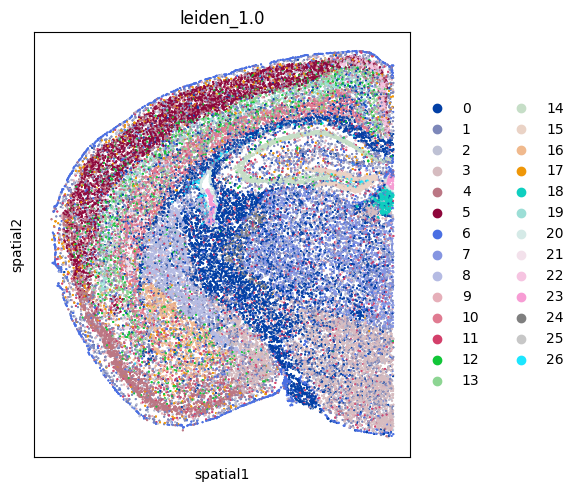

In [46]:
#Plot clusters in tissue space
sq.pl.spatial_scatter(adata, shape=None, color="leiden_1.0", size=1)

In [47]:
# Calculate enriched genes for each cluster
sc.tl.rank_genes_groups(adata, "leiden_1.0", method="wilcoxon")

/usr/local/lib/python3.8/dist-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/usr/local/lib/python3.8/dist-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/usr/local/lib/python3.8/dist-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result 

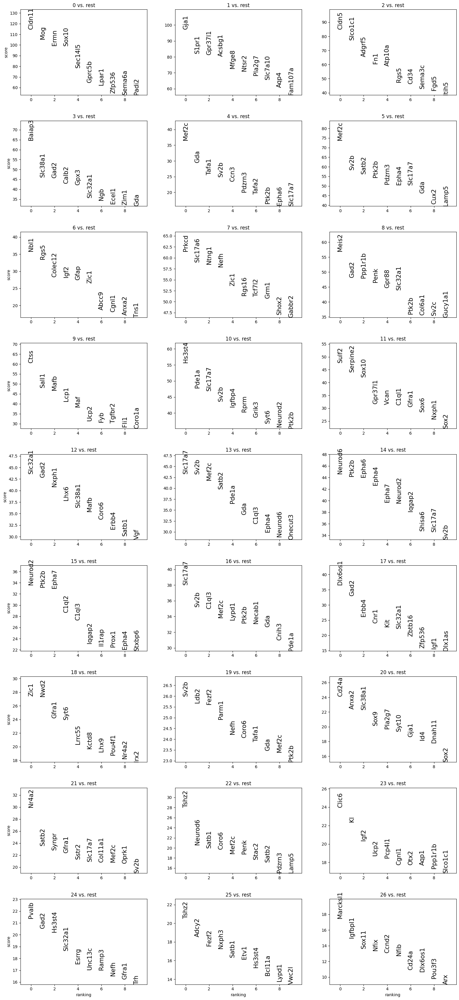

In [48]:
sc.pl.rank_genes_groups(adata, n_genes=10, sharey=False, gene_symbols='gene_name', ncols=3, fontsize=15)

# Spatial autocorrelating genes
Here we will use Moran's I to calculate the autocorrelation of genes. Genes that are expressed in cells that are located close to each other will have a higer Moran's I score.

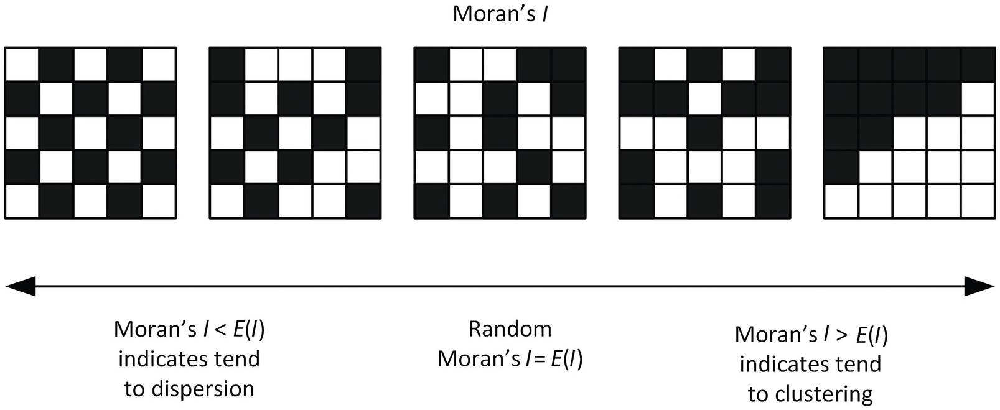

In [49]:
from IPython.display import Image, display

# Display the image
display(Image('/mnt/storage/nhecker/data/spatial/VisiumHD/moranI.png'))

In [50]:
# Make a graph of the spatial locations in 3D
sq.gr.spatial_neighbors(adata, coord_type="generic", spatial_key="spatial")

# Calculate Moran's I
sq.gr.spatial_autocorr(adata, mode="moran")

In [51]:
# Inspect results
adata.uns["moranI"]

,I,pval_norm,var_norm,pval_norm_fdr_bh
ENSMUSG00000070570,0.428295,0.000000,0.000009,0.000000
ENSMUSG00000021948,0.415220,0.000000,0.000009,0.000000
ENSMUSG00000005583,0.409800,0.000000,0.000009,0.000000
ENSMUSG00000047507,0.387496,0.000000,0.000009,0.000000
ENSMUSG00000037625,0.381243,0.000000,0.000009,0.000000
...,...,...,...,...
ENSMUSG00000102362,-0.003889,0.097785,0.000009,0.108844
ENSMUSG00000021359,-0.004141,0.083967,0.000009,0.094117
ENSMUSG00000026468,-0.004150,0.083538,0.000009,0.093730
ENSMUSG00000114028,-0.004459,0.068710,0.000009,0.077558


In [52]:
adata.uns["moranI"].index[:3]

Index(['ENSMUSG00000070570', 'ENSMUSG00000021948', 'ENSMUSG00000005583'], dtype='object')

Genes: ['Slc17a7', 'Prkcd', 'Mef2c']


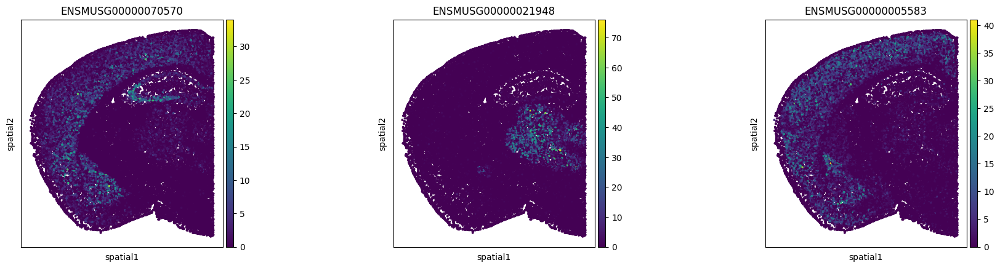

In [53]:
# Plot top 3 highest autocorrelating genes
genes_to_plot = adata.uns["moranI"].index[:3]
print(f'Genes: {[ensembl_to_gene[i] for i in genes_to_plot]}')

sq.pl.spatial_scatter(adata, shape=None, color=genes_to_plot, size=10)

Genes: ['Lhx4', '9630002D21Rik', 'Slc6a4']


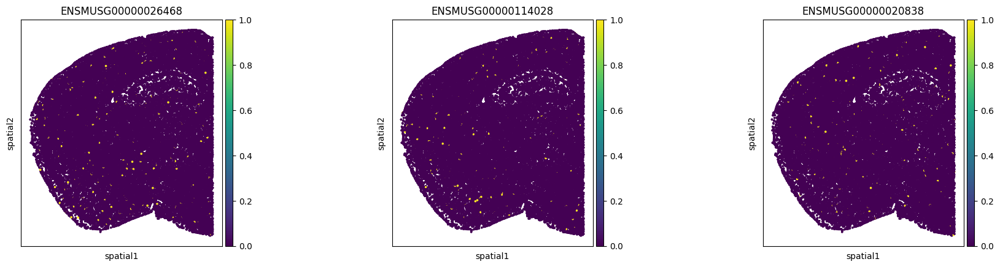

In [54]:
# Plot top 3 lowest autocorrelating genes
genes_to_plot = adata.uns["moranI"].index[-3:]
print(f'Genes: {[ensembl_to_gene[i] for i in genes_to_plot]}')

sq.pl.spatial_scatter(adata, shape=None, color=genes_to_plot, size=10, vmax=1)

# Spatial organization of cells
Here we will use the locations of all cells to calculate spatial enrichments.  
In other words we will find which cell types are colocalized within the tissue.

  0%|          | 0/1000 [00:00<?, ?/s]

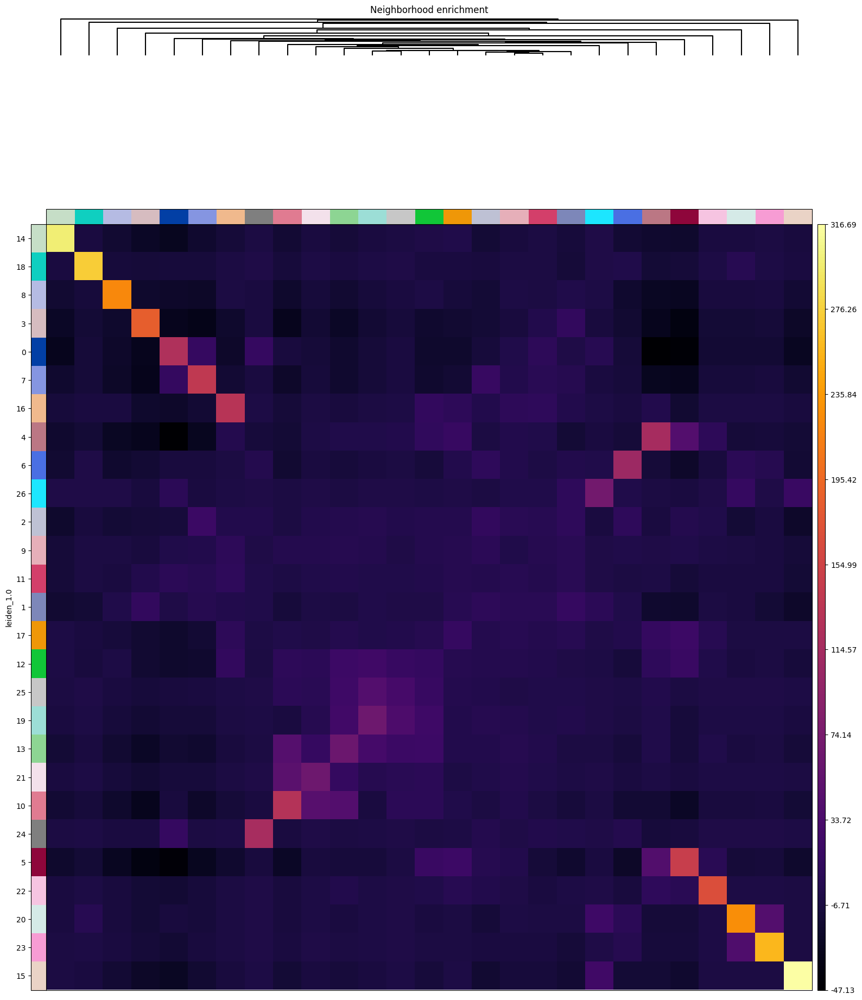

In [55]:
# Make a graph of the spatial locations in 3D
sq.gr.spatial_neighbors(adata, coord_type="generic", spatial_key="spatial")

# Calculate enrichment
sq.gr.nhood_enrichment(adata, cluster_key="leiden_1.0")

# Plot results
sq.pl.nhood_enrichment(adata, cluster_key="leiden_1.0", method="single", cmap="inferno", )
# (This plot is not always symetrical!)

### Cell types self-association
Find clusters where the cells of that cluster are localized close to other cells of the same cluster.

In [56]:
# Get the self association values, that are the diagonal of the matrix
n_clusters = len(adata.obs['leiden_1.0'].cat.categories)
diagonal = adata.uns['leiden_1.0_nhood_enrichment']['zscore'][np.eye(n_clusters, dtype=bool)]

# Rank values highest to lowest
sorted_index = np.argsort(diagonal)[::-1]

# Sort clusters with 
sorted_clusters = adata.obs['leiden_1.0'].cat.categories[sorted_index]

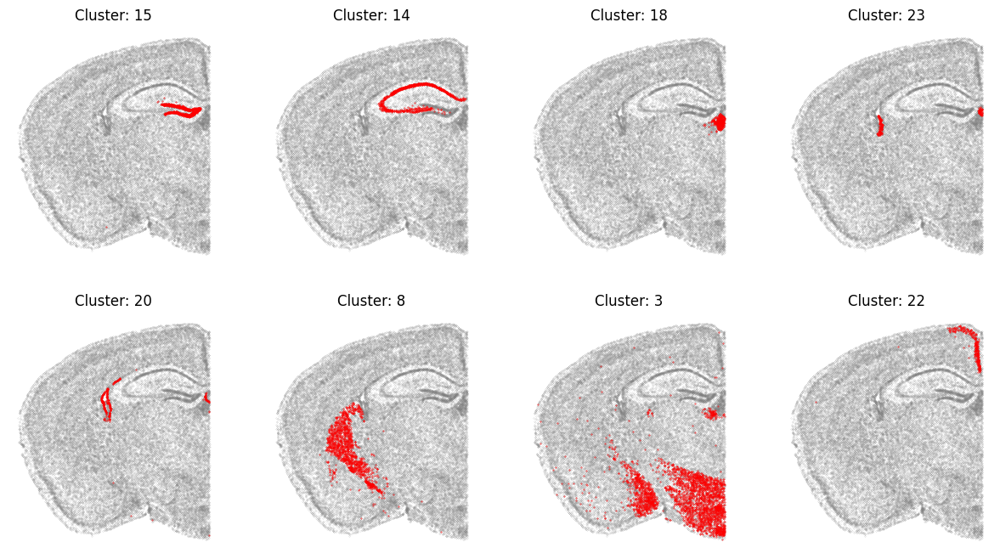

In [57]:
fig, axes = plt.subplots(figsize=(15,8), ncols=4, nrows=2)
for i, cluster in enumerate(sorted_clusters[:8]):
    ax = axes[int(i/4), i%4]
    ax.scatter(xy[:,0], xy[:,1], s=0.01, c='gray')
    filt = adata.obs['leiden_1.0'] == cluster
    ax.scatter(xy[filt,0], xy[filt,1], s=0.1, c='r')
    ax.set_title(f'Cluster: {cluster}')
    ax.set_aspect('equal')
    ax.set_axis_off()

### Cell types that avoid themselves
Find clusters where the cell have a "self-avoiding" pattern. 

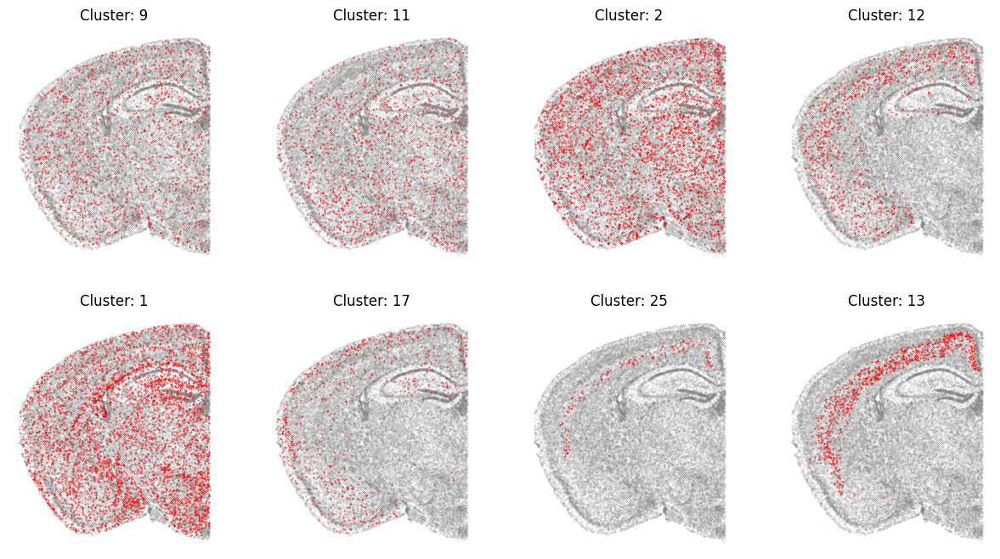

In [58]:
fig, axes = plt.subplots(figsize=(15,8), ncols=4, nrows=2)
for i, cluster in enumerate(sorted_clusters[-8:][::-1]):
    ax = axes[int(i/4), i%4]
    ax.scatter(xy[:,0], xy[:,1], s=0.01, c='gray')
    filt = adata.obs['leiden_1.0'] == cluster
    ax.scatter(xy[filt,0], xy[filt,1], s=0.1, c='r')
    ax.set_title(f'Cluster: {cluster}')
    ax.set_aspect('equal')
    ax.set_axis_off()

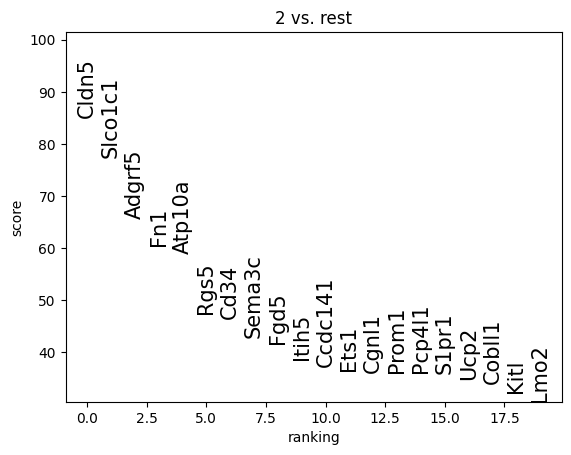

In [59]:
# Investigate group 2
sc.pl.rank_genes_groups(adata, n_genes=20, gene_symbols='gene_name', fontsize=15, groups='2')

### Spatial colocalization between cell types
Study clusters that colocalize in the tissue. 

In [60]:
# Get the enrichment data
data = (adata.uns['leiden_1.0_nhood_enrichment']['zscore'])

# Mask self-association = diagonal
data[np.eye(n_clusters, dtype=bool)] = -999

# Flatten the matrix and get the indices of the 8 largest values
flat_indices = np.argsort(data, axis=None)[-8:]

# Convert flat indices back to row and column indices
row_indices, col_indices = np.unravel_index(flat_indices, data.shape)

# Get cluster pairs
clusters = adata.obs['leiden_1.0'].cat.categories
pairs = list(zip(clusters[row_indices], clusters[col_indices]))

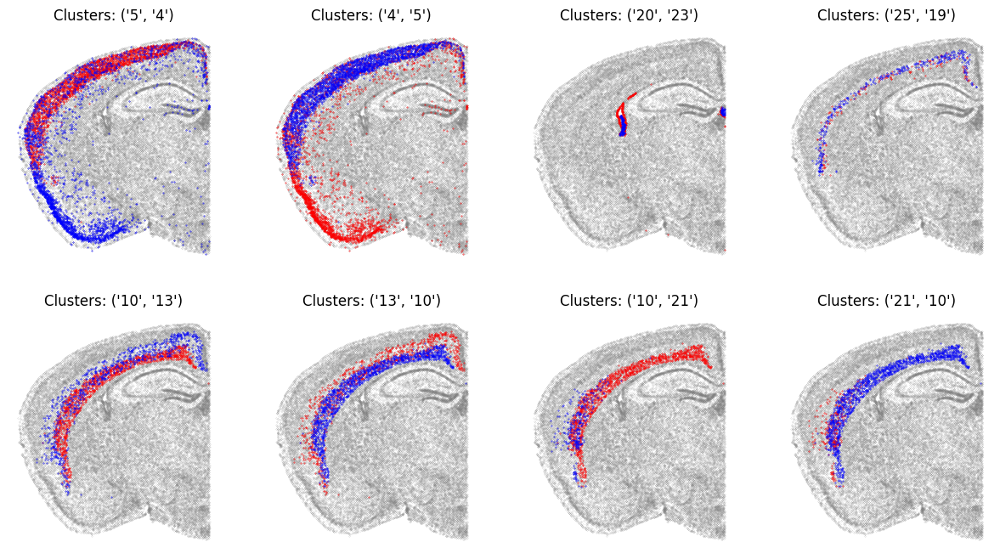

In [61]:
# Plot clusters that co-localize
fig, axes = plt.subplots(figsize=(15,8), ncols=4, nrows=2)
for i, p in enumerate(pairs):
    ax = axes[int(i/4), i%4]
    ax.scatter(xy[:,0], xy[:,1], s=0.01, c='gray')
    
    filt1 = adata.obs['leiden_1.0'] == p[0]
    ax.scatter(xy[filt1,0], xy[filt1,1], s=0.1, c='r', label=p[0])
    
    filt2 = adata.obs['leiden_1.0'] == p[1]
    ax.scatter(xy[filt2,0], xy[filt2,1], s=0.1, c='b', label=p[1])
    
    ax.set_title(f'Clusters: {p}')
    ax.set_aspect('equal')
    ax.set_axis_off()
    #ax.legend()